# Simran Kumari: Capstone project

#                        GIVING INSIGHTS AND FORECASTING              WALMART SALES

Data is one of the most essential commodities for any organization.Harnessing data and utilizing it to create effective marketing strategies and making better decisions is extremely essential for organizations. For a conglomerate as big as Walmart, it is necessary to organize and analyze the large volumes of data generated to make sense of existing performance and identify growth 
potential. Walmart operates approximately 10,500 stores and clubs in 20 countries and eCommerce websites. They employ 2.1 million associates around the world — nearly 1.6 million in the U.S. alone.
The world’s largest company by revenue WALMART,sells everything from groceries, home furnishings, body care products to electronics, clothing, etc. and generates a large amount of consumer data that it utilizes to predict customer buying patterns, future sales, and promotional plans and creating new
and innovative in-store technologies.

This project explores the performance of a subset of Walmart stores and forecasts future weekly sales for these stores based on several time series forecasting models like ARIMA, SARIMA, and VAR. An 
exploratory data analysis has been performed on the dataset to explore the effects of different
factors like holidays, fuel price, and temperature on Walmart’s weekly sales.

# PROBLEM STATEMENT

A retail store that has multiple outlets across the country are facing issues in managing the
inventory - to match the demand with respect to supply. I am a data scientist, who has to
come up with useful insights using the data and make prediction models to forecast the sales for
 the next 12 weeks.

# PROJECT OBJECTIVE

The main focus of this research is to predict Walmart’s sales based on the available historic data
from 45 stores located in different regions and identify whether factors like temperature, 
unemployment, fuel prices, etc affect the weekly sales of particular stores under study. This study 
also aims to understand whether the sales differ in holidays than normal days.The goal of this project
is to understand how different factors affect the sales for this conglomerate and how these findings 
could be used to create more efficient plan and strategy for improvements.

This study also includes an extensive exploratory data analysis on the provided Walmart dataset to
understand the following:
• Identifying total weekly sales per store.
• Identifying how muach sales decrease with the rise of the temperature.
• Identifying how much sales increase during holidays.
• Correlation between the different factors that affect sales.
• Average sales per year.
• Weekly sales as per region temperature, CPI, fuel price, unemployment.

IMPORTING LIBRARIES

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

C:\Users\shiva\anaconda3\lib\site-packages\scipy\__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


READING THE DATA AS PANDA DATAFRAME

In [2]:
data = pd.read_csv("Walmart data.csv",parse_dates = ['Date'])

In [3]:
data.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-05-02,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,2010-12-02,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,2010-05-03,1554806.68,0,46.50,2.625,211.350143,8.106


# DATA DESCRIPTION

This given dataset contains information about 45 walmart stores IMPORTED BELOW as "Walmart data.csv".
In total, there are 6435 rows and 8 columns of features in the dataset.

It contains additional features regarding the store, as mentioned below-
Store - the store number.
Date - The date of the week where this observation was taken.
Temperature - the average temperature in the region of particular store.
Fuel_Price - the cost of fuel in the region of store.
CPI - the consumer price index.
Unemployment - the unemployment rate.
IsHoliday - whether the week is a special holiday week

# PERFORMING EDA

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Store         6435 non-null   int64         
 1   Date          6435 non-null   datetime64[ns]
 2   Weekly_Sales  6435 non-null   float64       
 3   Holiday_Flag  6435 non-null   int64         
 4   Temperature   6435 non-null   float64       
 5   Fuel_Price    6435 non-null   float64       
 6   CPI           6435 non-null   float64       
 7   Unemployment  6435 non-null   float64       
dtypes: datetime64[ns](1), float64(5), int64(2)
memory usage: 402.3 KB


In [5]:
# copying the data to another variable so that our original data will not get 
# altered
data1 = data.copy()

In [6]:
# how many stores do we have in our data
data1['Store'].max()

45

In [7]:
data1.shape

(6435, 8)

In [8]:
#no negative values present in data
data1.loc[data1['Weekly_Sales']<=0] 


,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment


In [9]:
#null values in data (perecntage)
nullpercen = data1.isnull().mean() * 100
nullpercen

Store           0.0
Date            0.0
Weekly_Sales    0.0
Holiday_Flag    0.0
Temperature     0.0
Fuel_Price      0.0
CPI             0.0
Unemployment    0.0
dtype: float64

In [10]:
data1.describe()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,6435.000000,6.435000e+03,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000
mean,23.000000,1.046965e+06,0.069930,60.663782,3.358607,171.578394,7.999151
std,12.988182,5.643666e+05,0.255049,18.444933,0.459020,39.356712,1.875885
min,1.000000,2.099862e+05,0.000000,-2.060000,2.472000,126.064000,3.879000
25%,12.000000,5.533501e+05,0.000000,47.460000,2.933000,131.735000,6.891000
50%,23.000000,9.607460e+05,0.000000,62.670000,3.445000,182.616521,7.874000
75%,34.000000,1.420159e+06,0.000000,74.940000,3.735000,212.743293,8.622000
max,45.000000,3.818686e+06,1.000000,100.140000,4.468000,227.232807,14.313000


# PRE-PROCESSING STEPS

Data has been checked for inaccuracies and missing or negative values as part of
the initial EDA.
Python packages like ‘matplotlib’, ‘seaborn’,‘plotly’, and several others are
used for more detailed information about each store.
The boolean ‘Holiday_Flag’ column in the dataset contains information about 
whether the weekly date was a holiday week or not. As observed in the EDA above,
sales have been higher during the holiday season as compared to non-holiday 
season sales, hence the ‘Holiday_Flag’ column has been used for further analysis.
To identify the average sale of each of the walmart store i have used matplotlib and seaborn libraries.



Pre-processing is a step in the data analysis process that takes raw data and 
transforms it into a format that can be understood and analyzed easily. Data has been checked for inaccuracies and missing or negative values as part of
the initial EDA so, we don't have to clean our data as it doesn't contain any 
missing values or fields. But we do have to create a structured and well organised dataset that the information can be easily accessible while analysing the data.
we will perform several steps to make this data interpretable:
1)The data is related to stores,dates and their sales.So we will mostly be
focusing on these columns.Firstly we will group our data by 'Store' and 'Date' 
column.
2)To analyse the data thoroughly, will section the date column in 'Day', 'Week'
'Month' and 'Year'.Because we will be analysing the sales in the basis of years
and months.
3)Importing calender library to convert the months number to 
months names.
4)Analysing the data through some of the python libraries like plotly, Matplot 
and Seaborn.

Grouping by store

In [11]:
data1=data1.groupby(["Store","Date"])[["Weekly_Sales", "Holiday_Flag", "Temperature","Fuel_Price",
                 "CPI", "Unemployment"]].sum()
data1.reset_index(inplace=True)

In [12]:
data1.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,2010-01-10,1453329.50,0,71.89,2.603,211.671989,7.838
1,1,2010-02-04,1594968.28,0,62.27,2.719,210.820450,7.808
2,1,2010-02-07,1492418.14,0,80.91,2.669,211.223533,7.787
3,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
4,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106


In [13]:
#importing calendar library for the month from numbers to names
import calendar

In [14]:
# Extracting details from date given. so that can be used for seasonal checks or grouping

data1["Day"]=data1.Date.dt.day
data1["Month"]=data1.Date.dt.month
data1["Year"]=data1.Date.dt.year

# Changing the Months value from numbers to real values like Jan, Feb to Dec
data1['Month'] = data1['Month'].apply(lambda x: calendar.month_abbr[x])

data1.tail()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Day,Month,Year
6430,45,2012-10-08,733037.32,0,78.65,3.722,191.162613,8.684,8,Oct,2012
6431,45,2012-10-19,718125.53,0,56.47,3.969,192.330854,8.667,19,Oct,2012
6432,45,2012-10-26,760281.43,0,58.85,3.882,192.308899,8.667,26,Oct,2012
6433,45,2012-11-05,770487.37,0,61.24,3.889,190.976417,8.567,5,Nov,2012
6434,45,2012-12-10,734464.36,0,54.47,4.000,192.327265,8.667,10,Dec,2012


In [15]:
#adding a 'week' column to the dataset for further analysis
data1['week'] = data1['Date'].dt.week
data1[:15]

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Day,Month,Year,week
0,1,2010-01-10,1453329.50,0,71.89,2.603,211.671989,7.838,10,Jan,2010,1
1,1,2010-02-04,1594968.28,0,62.27,2.719,210.820450,7.808,4,Feb,2010,5
2,1,2010-02-07,1492418.14,0,80.91,2.669,211.223533,7.787,7,Feb,2010,5
3,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106,19,Feb,2010,7
4,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106,26,Feb,2010,8
5,1,2010-03-09,1540163.53,0,81.21,2.577,211.531248,7.787,9,Mar,2010,10
6,1,2010-03-12,1548033.78,0,49.27,2.708,211.607193,7.838,12,Mar,2010,10
7,1,2010-03-19,1472515.79,0,54.58,2.720,211.215635,8.106,19,Mar,2010,11
8,1,2010-03-26,1404429.92,0,51.45,2.732,211.018042,8.106,26,Mar,2010,12
9,1,2010-04-06,1615524.71,0,80.69,2.705,211.176428,7.808,6,Apr,2010,14


In [16]:
df_weeks = data1.groupby('week').sum()
df_weeks.head()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Day,Year
week,,,,,,,,,
1,4140,1.815590e+08,0,12163.83,619.357,30873.561293,1446.410,1215,361980
2,2070,8.269676e+07,0,3167.09,291.404,15430.151991,710.979,1215,181035
3,2070,8.273564e+07,0,3476.88,293.341,15443.190027,710.979,1845,181035
4,2070,7.943483e+07,0,3455.57,294.581,15456.228061,710.979,2475,181035
5,3105,1.462024e+08,0,7908.33,419.259,22981.152338,1099.558,630,271440


In [17]:
import plotly.express as px
fig = px.line( data_frame = df_weeks, x = df_weeks.index, y = 'Weekly_Sales',
              labels = {'Weekly_Sales' : 'Weekly Sales', 'x' : 'Weeks' },
              title = 'Sales over weeks')
fig.update_traces(line_color='cyan', line_width=3)

From the above graph we can see that weekly sales for each store are very high. 
So we will scale down the values for our ease.

In [18]:
plt.figure(figsize=(10, 6))
data1["Weekly_Sales"]=data1.Weekly_Sales/1000

data1.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Day,Month,Year,week
0,1,2010-01-10,1453.32950,0,71.89,2.603,211.671989,7.838,10,Jan,2010,1
1,1,2010-02-04,1594.96828,0,62.27,2.719,210.820450,7.808,4,Feb,2010,5
2,1,2010-02-07,1492.41814,0,80.91,2.669,211.223533,7.787,7,Feb,2010,5
3,1,2010-02-19,1611.96817,0,39.93,2.514,211.289143,8.106,19,Feb,2010,7
4,1,2010-02-26,1409.72759,0,46.63,2.561,211.319643,8.106,26,Feb,2010,8


<Figure size 720x432 with 0 Axes>

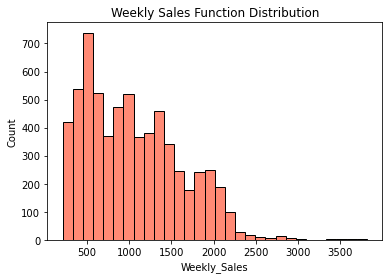

In [19]:
sns.histplot(data1.Weekly_Sales, kde=False, bins=30, color = 'tomato')
plt.title('Weekly Sales Function Distribution')
plt.show()

IMPACT OF DIFFERENT FEATURES ON SALES

After studying the overall summaries the Walmart
dataset, this report will now throw light upon the effect of different factors (such as
holidays, CPIs, unemployment, etc.) on the weekly sales. It has always
been an integral part of this study to understand the effect that these factors have on
Walmart’s sales performance. I will also create several visualizations that shed light on
the difference in Walmart store sales on holidays versus non-holiday days, the impact
of store size on weekly sales, and finally create a correlation matrix to examine
the correlation between the many factors included in the dataset.

In [20]:
def scatter(dataset, column):
    plt.figure()
    sns.scatterplot(x=data1[column], y=data1['Weekly_Sales'], hue=data1.Year, palette="colorblind")
    #plt.legend(loc='upper right')
    plt.legend(bbox_to_anchor=(1.19, 1), loc='upper right')
    plt.ylabel('Weekly Sales')
    plt.xlabel(column)

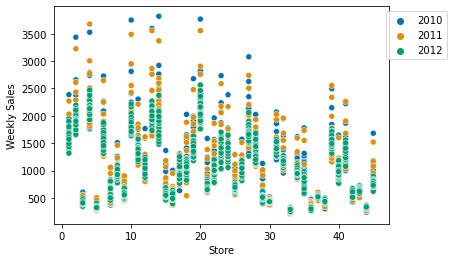

In [21]:
scatter(data1, 'Store')

As visible in th above scatterplot that 20 stores are having good sales , from store 30 -45 are having
average sales. Also most of the sales are of year 2012 (the green plots)

IMPACT OF FUEL PRICES ON SALES

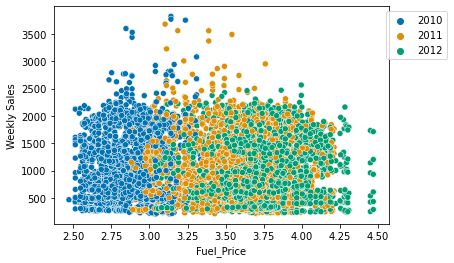

In [22]:
scatter(data1, 'Fuel_Price')

An economist from Brown University used gasoline price data to study if consumers change their buying 
behavior based on changes in fuel prices. The economist assumes that even a slight increase in fuel prices significantly adds up to
the annual expenditure and thus discourages consumers from actively buying their required goods and services.
This can also slightly be observed in the visualization above while there seems to
be a decrease in sales when fuel price is higher than 4.25 dollars, sales are higher when
fuel price ranges between 2.75 to 3.75 dollars. While there is no definite pattern that
proves this, some observations do support the theory that lower fuel prices encourage
higher sales.

IMPACT OF CPI ON SALES

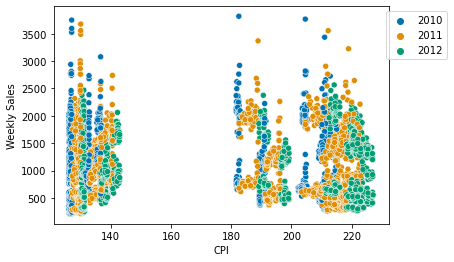

In [23]:
scatter(data1, 'CPI')

According to the US Bureau of Labor Statistics, CPI (Consumer Price Index) is defined
as the measure of the average change over time in the prices paid by urban consumers
for a market basket of consumer goods and services (STATISTICS, n.d.).
In layman’s terms, CPI is a measure that assesses the price changes that are associated with the cost of living for each individual.
CPI is a great measure for the government when studying inflation (i.e. an increase in the prices of a representative basket of
goods consumed) and is often used to evaluate and adjust government assistance needs
based on income levels and provide wage adjustments with respect to changing cost of
living expenses. A higher CPI generally means that the price of goods has increased
and that an individual needs to spend more money to maintain the same standard of
living.
In our scatter plot above, we can identify three different clusters around different
ranges of CPI; while there seems to be no visible relationship between the change in
CPI and weekly sales for Walmart stores (sales still occur at high CPI rates), the only
negligible observation that can be made is the high amount of sales in year 2010
when CPI is at a low rate of 140.

IMPACT OF UNEMPLOYMENT ON SALES

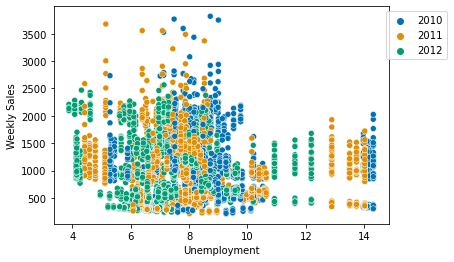

In [24]:
scatter(data1, 'Unemployment')

Spending sharply drops on the onset of unemployment: a higher unemployment index
would generally result in a fall in sales as individuals tend to decrease overall spending.
In our dataset, unemployment is presented through an index of the unemployment rate
during that week in the region of the store. From our scatter plot, it is easier to gather
the following information:

• There seems to be a visible decrease in sales when the unemployment index is 
higher than 9.
• Even when the unemployment index is higher than 9, there is no significant
change in the average sales of stores when compared to the overall sales.
• There seems to be a significant drop in sales in year 2012 when the
unemployment index increases.
• Highest recorded sales in year 2010 and 2011 occur around the unemployment
index of 5 to 9; this gives ambiguous ideas about the impact of unemployment
on sales of the stores.

IMPACT OF TEMPERATURE ON SALES

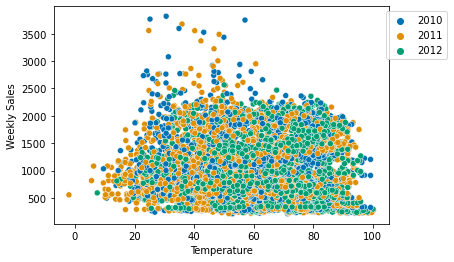

In [25]:
scatter(data1, 'Temperature')

It has widely been known in the retail sector that weather has a profound effect on
sales. While warmer weather promotes sales, cold/harsh or extremely hot weather is
generally not a great encouragement for shoppers to get outdoors and spend money.
Generally speaking, temperatures between 40 to 70 degrees Fahrenheit are considered
as favorable for humans to live in considering they are not as hot or cold.
As seen above, the highest sales occur for most store types between the range of
22 to 60 degrees Fahrenheit, thus proving the idea that pleasant weather encourages
higher sales. Sales are relatively lower for very low and very high temperatures but
seem to be adequately high for favorable climate conditions.

In [26]:
data1.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Day,Month,Year,week
0,1,2010-01-10,1453.32950,0,71.89,2.603,211.671989,7.838,10,Jan,2010,1
1,1,2010-02-04,1594.96828,0,62.27,2.719,210.820450,7.808,4,Feb,2010,5
2,1,2010-02-07,1492.41814,0,80.91,2.669,211.223533,7.787,7,Feb,2010,5
3,1,2010-02-19,1611.96817,0,39.93,2.514,211.289143,8.106,19,Feb,2010,7
4,1,2010-02-26,1409.72759,0,46.63,2.561,211.319643,8.106,26,Feb,2010,8


In [27]:
salesbymonth = data1.groupby('Month')["Weekly_Sales"].sum()
salesbymonth

Month
Apr    645323.88962
Aug    564231.69951
Dec    599076.09117
Feb    522025.68289
Jan    426426.26505
Jul    593313.93718
Jun    575017.96377
Mar    553486.40957
May    605696.59219
Nov    459169.33589
Oct    602918.85742
Sep    590532.26285
Name: Weekly_Sales, dtype: float64

In [28]:
weekly_sm_2010 = data1[data1.Year==2010]['Weekly_Sales'].groupby(data1['Month']).mean()
weekly_sm_2011 = data1[data1.Year==2011]['Weekly_Sales'].groupby(data1['Month']).mean()
weekly_sm_2012 = data1[data1.Year==2012]['Weekly_Sales'].groupby(data1['Month']).mean()

In [29]:
data1.Year.unique()

array([2010, 2011, 2012], dtype=int64)

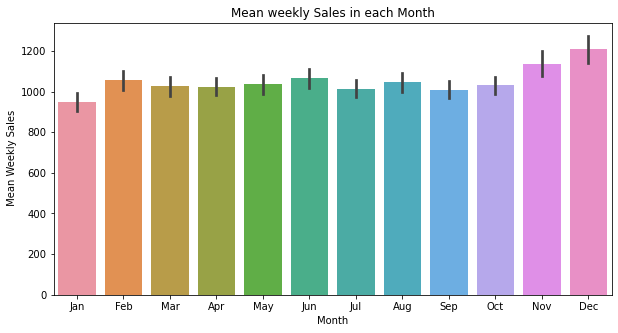

In [30]:
plt.subplots(figsize=(10,5))
sns.barplot(x="Month", y="Weekly_Sales", data=data1 ,orient='v')
plt.xlabel('Month')
plt.ylabel(' Mean Weekly Sales')
plt.title('Mean weekly Sales in each Month')
#plt.savefig('./images/Mean_Weekly_Sales_vs_Months.png')
plt.show()

# showing sales graph per month by year seperately.

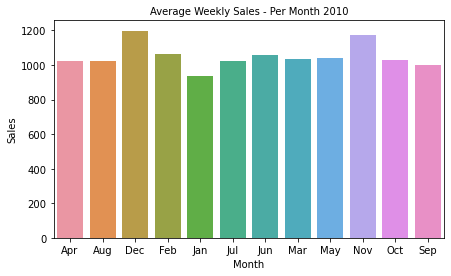

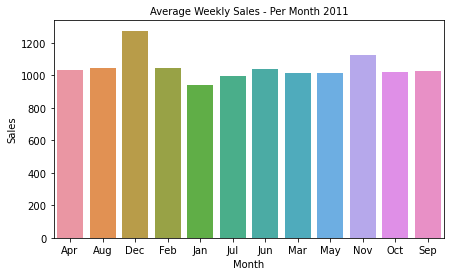

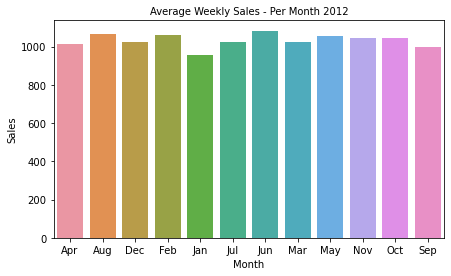

In [31]:
plt.figure(figsize=(7,4))
plt.ylabel('Sales', fontsize=10)
plt.title('Average Weekly Sales - Per Month 2010', fontsize=10)
sns.barplot(weekly_sm_2010.index, weekly_sm_2010.values)

plt.figure(figsize=(7,4))
plt.title('Average Weekly Sales - Per Month 2011', fontsize=10)
plt.ylabel('Sales', fontsize=10)
sns.barplot(weekly_sm_2011.index, weekly_sm_2011.values)

plt.figure(figsize=(7,4))
plt.title('Average Weekly Sales - Per Month 2012', fontsize=10)
plt.ylabel('Sales', fontsize=10)
sns.barplot(weekly_sm_2012.index, weekly_sm_2012.values);


The graphs above clearly depicts that the months of November and December recorded the highest average
sales for 2010 and 2011. The dataset provided by Walmart contained no weekly sales information for the
last two months of the year 2012, hence no conclusion can be drawn for that year.
This graph also shows that the month of January tends to have the lowest average sales compared to 
every other month in the whole year.

# looking at weekly sales by year

In [32]:
weekly_sales_2010 = data1[data1.Year==2010]['Weekly_Sales'].groupby(data1['week']).mean()
weekly_sales_2011 = data1[data1.Year==2011]['Weekly_Sales'].groupby(data1['week']).mean()
weekly_sales_2012 = data1[data1.Year==2012]['Weekly_Sales'].groupby(data1['week']).mean()

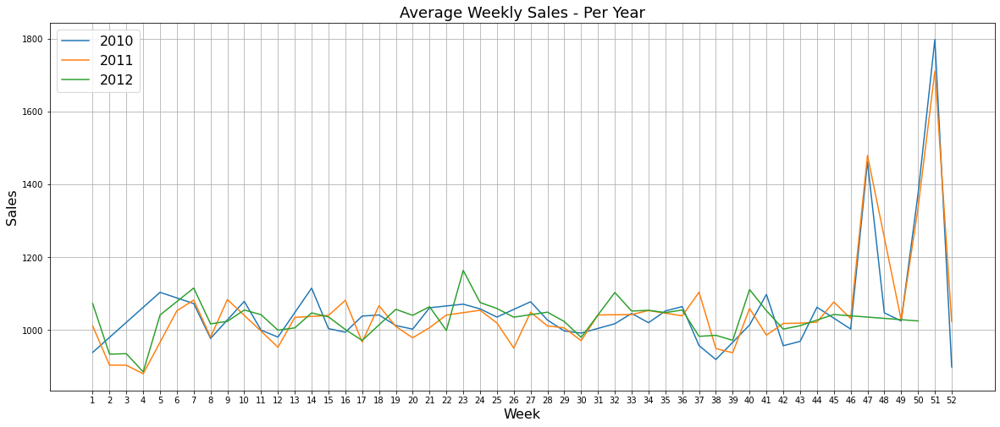

In [33]:
plt.figure(figsize=(20,8))
sns.lineplot(weekly_sales_2010.index, weekly_sales_2010.values)
sns.lineplot(weekly_sales_2011.index, weekly_sales_2011.values)
sns.lineplot(weekly_sales_2012.index, weekly_sales_2012.values)
plt.grid()
plt.xticks(np.arange(1, 53, step=1))
plt.legend(['2010', '2011', '2012'], loc='best', fontsize=16)
plt.title('Average Weekly Sales - Per Year', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Week', fontsize=16)
plt.show()

The week over week overview again helps us in understanding if there is an increase in
sales during holiday weeks each year, i.e. the weeks of Thanksgiving, Christmas, New year etc.
As we can see that the sales in more than half weeks of a year are quite similar for all three years.
There is an evident hike in sales in weeks 47 and 51 as we can see theses are the last weeks 
of the year so we can assume that it must be the christmas time, proving again that sales rise during the holiday season. Due
to the insufficiency of data for the last weeks of year 2012 , these conclusions have only been made
based on the data available from 2010 and 2011. This graph also tells that there is a
distinguished pattern of decline immediately following Christmas and New Year’s.

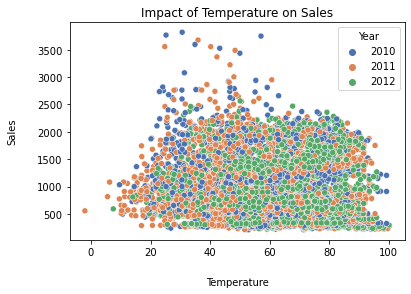

In [34]:
sns.scatterplot(x=data1.Temperature, y=data1.Weekly_Sales, hue=data1.Year, palette="deep")
plt.xlabel('Temperature', fontsize=10, labelpad=20)
plt.ylabel('Sales', fontsize=10, labelpad=20)
plt.title('Impact of Temperature on Sales')
plt.show()

In [35]:
## checking the relationships of other features with weekly sales.

In [36]:
px.histogram(data1, x = "Fuel_Price", y = "Weekly_Sales", color = "Holiday_Flag" ,marginal='box')

In [37]:
px.histogram(data1, x = "Temperature", y = "Weekly_Sales", color = "Holiday_Flag"
             ,barmode = "overlay" ,marginal = "box")

As we can see in the above graph that sales are slightly higher when it's a holiday than a no holiday 
on the same temperature. Weekly sale are relatively low when the temperature is too low ang too high.

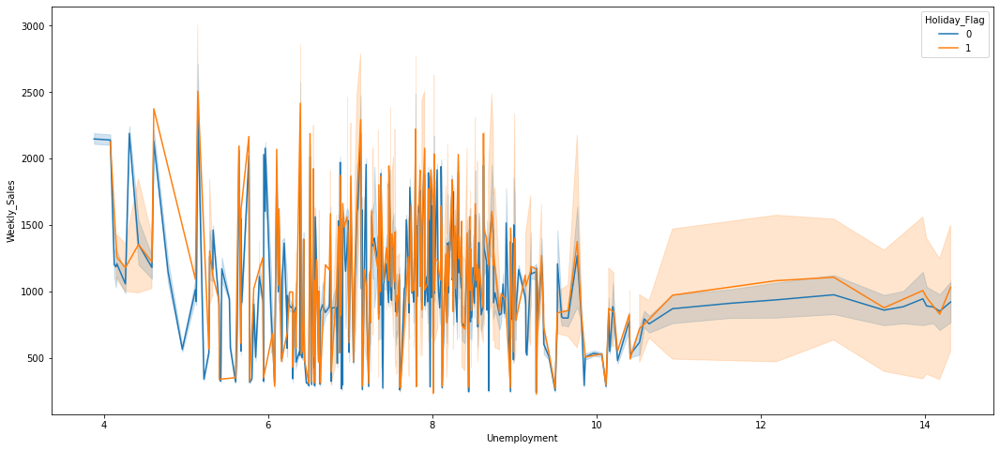

In [38]:
plt.figure(figsize=(18,8))
sns.lineplot ( data = data1, x = 'Unemployment', y =  'Weekly_Sales', hue = 'Holiday_Flag');

In the above graph we can see that the sales are fluctuating between a range till the unemployment rate is 10.
Then there is a stationarity in the sales but the weekly sales is slightly higher when its a holiday week
than a non holiday week despite the fact that the unemployment rate is high.

In [39]:
plt.figure(figsize=(10,8))
px.histogram(data1, x='CPI', y ='Weekly_Sales', color='Holiday_Flag')

#sales are high usually when the CPI is low also rise a little bit on the holidays.

<Figure size 720x576 with 0 Axes>

# Holiday vs non-holiday

In [40]:
sales = data1.groupby('Holiday_Flag')['Weekly_Sales'].mean()
counts = data1.Holiday_Flag.value_counts()

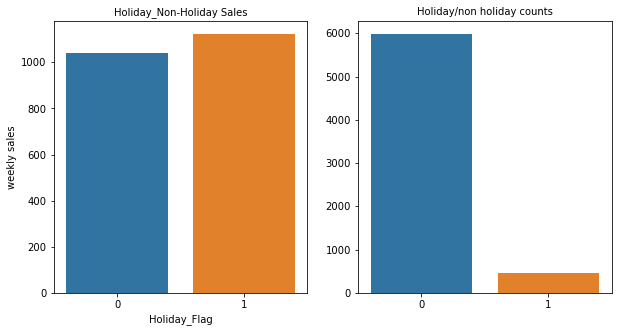

In [41]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.title("Holiday_Non-Holiday Sales", fontsize= 10)
plt.ylabel("weekly sales")
sns.barplot(sales.keys(), sales.values)


plt.subplot(1,2,2)
plt.title("Holiday/non holiday counts", fontsize = 10)
sns.barplot(counts.keys(), counts.values);

The dataset provided includes data about the sales that occur during holiday periods of Thanksgiving,Christmas, etc. It was crucial to compare the difference between sales during holidays and normal weeks to understand if the holiday season gathers higher sales. 
For this comparison, as you can see above that i first counted the number of holidays in a year and compared sales during the holiday dates versus the normal days.
While the holiday dates accounted a less percent of the days in the year, they still have higher weekly sales than the rest of the year combined (as seen in the image above). The above ‘Holiday_Flag’ = TRUE or FALSE sales and counts highlights that even though the number of holiday dates is far less than the normal dates in the dataset, they still accumulate more sales.

# calculating average of weekly sales by store

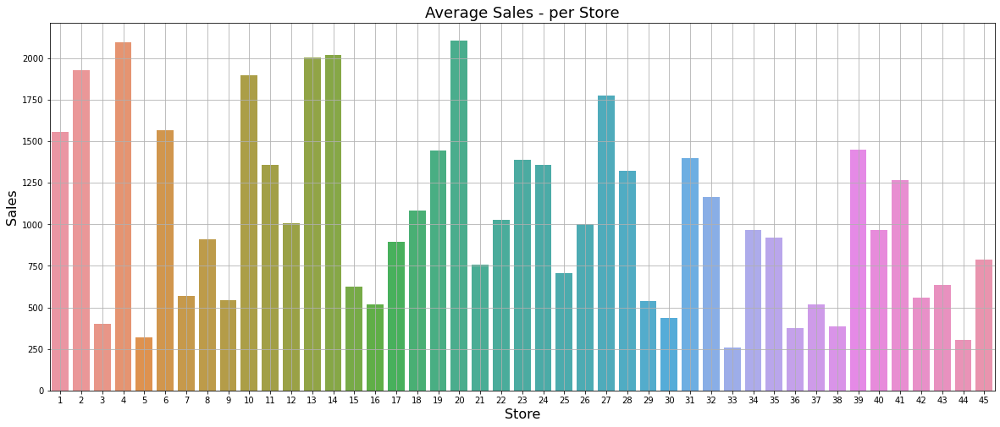

In [42]:
weekly_sales = data1['Weekly_Sales'].groupby(data1['Store']).mean()
plt.figure(figsize=(20,8))
plt.style.use('default')
sns.barplot(weekly_sales.index, weekly_sales.values)
plt.grid()
plt.title('Average Sales - per Store', fontsize=18)
plt.ylabel('Sales', fontsize=16)
plt.xlabel('Store', fontsize=16)
plt.show()

There are several stores it is crucial to look at the average sales for each of these stores. 
In total there are 45 stores presented in the Walmart dataset and from the above plotted graph it can
be concluded that store numbers 4 and 20 have the highest average sales. It should also be noted that 
there is a very high difference between the average sales for each of the stores; while some stores
record huge sales, some others lack vastly in the area.
This could be dependent on factors like the kinds of products sold by the store,the geographic 
location, temperature, unemployment in the vicinity, etc.
In the above graph we can see that there are only some stores having sales more than 1500 that could be 
because of many reasons like their service, surroundings , location etc.

# Finding the correlation between columns using heatmap

Correlation testing has been performed to understand if there is a correlation between the individual
factors and weekly sales and whether such factors have any impact on sales made by Walmart.
Each variable in the table is correlated to each of the other variables in the table and helps in 
understanding which variables are more closely related to each other.With the numerous variables 
available in this dataset, it became imperative to study correlations between some of them. By default,
this matrix also calculates correlation through Pearson’s Correlation Coefficient that calculates
the linear relationship between two variables, within a range of −1 to +1. The closer the correlation
to |1|, the higher the linear relationship between the variables and vice versa.

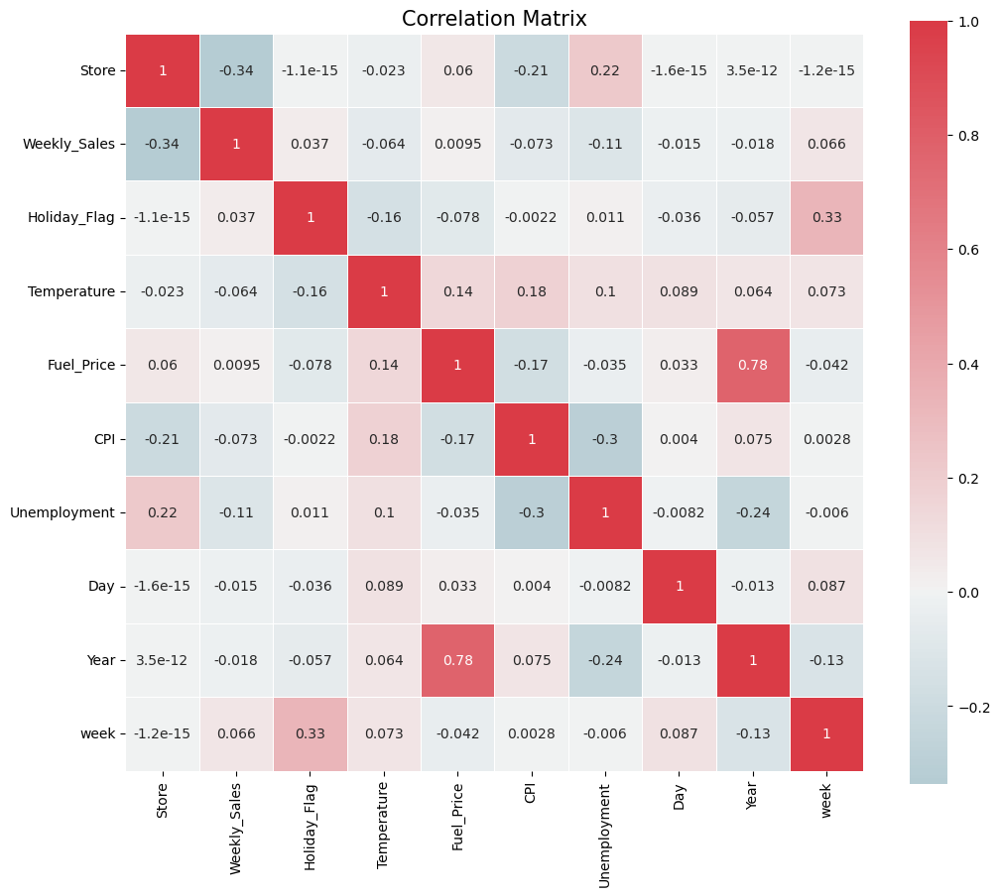

In [43]:
corr = data1.corr()
cmap = sns.diverging_palette(220, 10, as_cmap=True)
plt.figure(figsize=(12,10))
plt.title('Correlation Matrix', fontsize=15)
sns.heatmap(corr, cmap=cmap, center=0,
            square=True, linewidths=.5, annot=True);

By checking the direct correlation of features in the above heatmapcreated using the seaborn library
there is no much promising 
correlations. There are no much correlation within the features as well. In a way this is good because
there won't be multicollinearity that we have to take care while running models.

If i roughly analyse above heatmap gives the following information:
• There is a slight correlation between weekly sales and Holiday_Flag.
• There seems to be a negative correlation between weekly sales and temperature,unemployment, CPI. 
This could suggest that sales are not impacted by changes in these factors.
• Also Fuel_Price and year are well correlated as their score is 0.78



# CHOOSING THE ALGORITHM FOR THE PROJECT

Trying to find and implement the most effective model is the biggest challenge 
of this study. Selecting a model will depend solely on the kind of data
available and the analysis that has to be performed on the data.
Several models have been studied as part of this study that were selected based 
on different aspects of our dataset; the main purpose of creating such models is
to predict the weekly sales for different Walmart stores.
With Time series forecasting we can use several models like ARIMA, Seasonality 
with ARIMA(SARIMA), prophet , Linear Regression and several other models.But the
most preferred models are ARIMA, SARIMA and prophet.

ARIMA - ARIMA is a model which is used for predicting future trends on a time 
        series data. It is model that form of regression analysis.
        · AR (Autoregression): Model that shows a changing variable that 
            regresses on its own lagged/prior values.
        · I (Integrated): Differencing of raw observations to allow for the time
            series to become stationary.
        · MA (Moving average): Dependency between an observation and a residual
            error from a moving average model.
For ARIMA models, a standard notation would be ARIMA with p, d, and q, where 
integer values substitute for the parameters to indicate the type of ARIMA model
used.

SARIMA - Seasonal ARIMA is an extension of ARIMA that explicitly supports 
        univariate time series data with a seasonal component. It adds three 
        new hyperparameters to specify the autoregression (AR), differencing (I)
        and moving average (MA) for the seasonal component of the series, as 
        well as an additional parameter for the period of the seasonality.


PROPHET - Prophet is a procedure for forecasting time series data based on an 
        additive model where non-linear trends are fit with yearly, weekly, and
        daily seasonality, plus holiday effects. It works best with time series
        that have strong seasonal effects and several seasons of historical data.
        Prophet is robust to missing data and shifts in the trend, and typically
        handles outliers well.
Here for this dataset, i am going to use Prophet model because i have to deal 
with seasonality and trend in my data and i found the prophet model better when
you have to deal with a data having irregular frequencies.

# MODEL

We are going to use the PROPHET MODEL for Walmart forecasting to handle the
trends and seasonality of each store with ease.

# MODEL EVALUATION AND STEPS

Steps to perform:
1)Prophet follows the sklearn model API.
2)First up, we create an instance of the Prophet class and then call its fit 
and predict methods.
3)The input to Prophet is always a dataframe with two columns - ds and y.
Prophet imposes the strict condition that the input columns must be named as ds
(the time column) and y (the metric column).
So, we must rename the columns in our dataframe.
4)The ds (datestamp) column should be of a format expected by Pandas, ideally
YYYY-MM-DD for a date or YYYY-MM-DD HH:MM:SS for a timestamp.In our case i have 
already changed the type of my date column to right format.
5)The y column must be numeric, and represents the measurement we wish to 
forecast.

FETCHING THE REQUIRED COLUMNS:

In [44]:
data1 = data.iloc[:,0:3]
data1.head()

,Store,Date,Weekly_Sales
0,1,2010-05-02,1643690.90
1,1,2010-12-02,1641957.44
2,1,2010-02-19,1611968.17
3,1,2010-02-26,1409727.59
4,1,2010-05-03,1554806.68


# SEPARATING EACH STORE DATA

In [45]:
# storing all store numbers into  a dictionary
stores = []
for i in range(1,46):
    stores.append(i)
    
stores

[1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45]

By using for loop storing data into 45 separate dataframes by their store number to forecast them separately. 

In [46]:
store_dfs = {}
for store in stores:
    store_df = data1[data1['Store']== store]
    store_dfs[store] = store_df

In [47]:
store_dfs[1]

,Store,Date,Weekly_Sales
0,1,2010-05-02,1643690.90
1,1,2010-12-02,1641957.44
2,1,2010-02-19,1611968.17
3,1,2010-02-26,1409727.59
4,1,2010-05-03,1554806.68
...,...,...,...
138,1,2012-09-28,1437059.26
139,1,2012-05-10,1670785.97
140,1,2012-12-10,1573072.81
141,1,2012-10-19,1508068.77


PLOTTING GRAPHS OF EACH STORE AVALAIBLE DATA

<Figure size 1000x300 with 0 Axes>

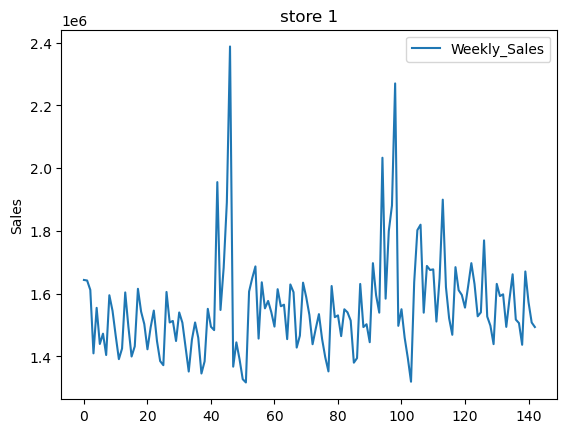

<Figure size 1000x300 with 0 Axes>

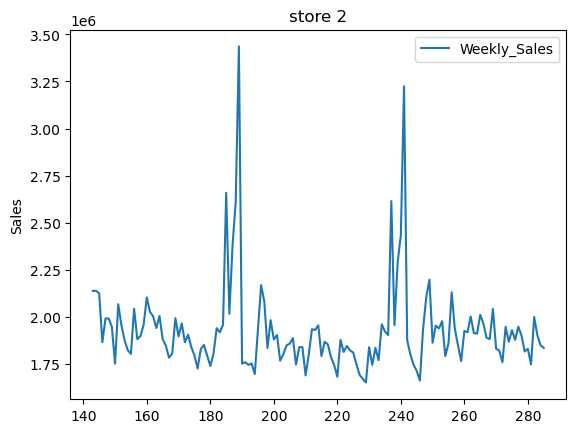

<Figure size 1000x300 with 0 Axes>

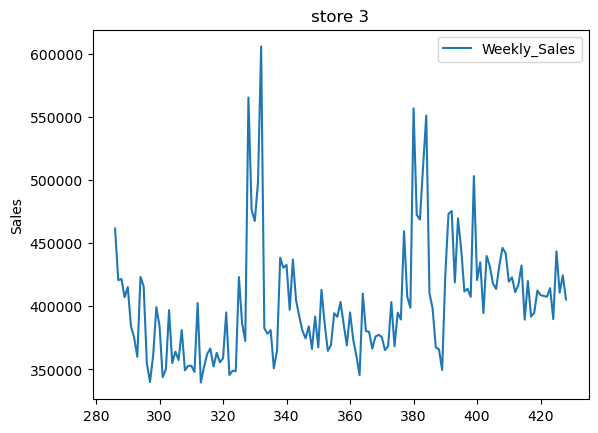

<Figure size 1000x300 with 0 Axes>

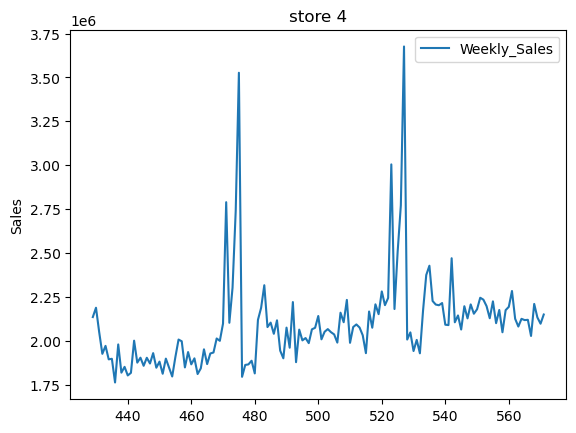

<Figure size 1000x300 with 0 Axes>

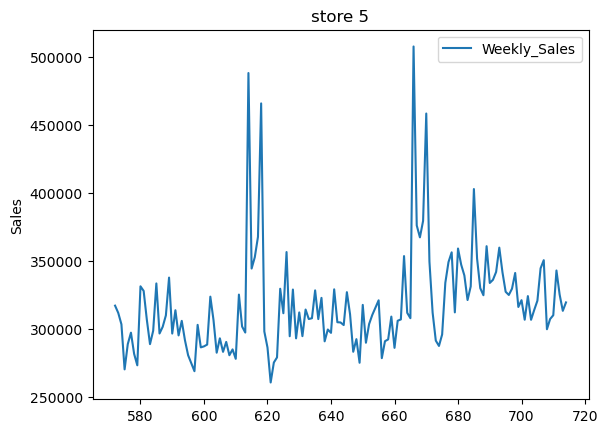

<Figure size 1000x300 with 0 Axes>

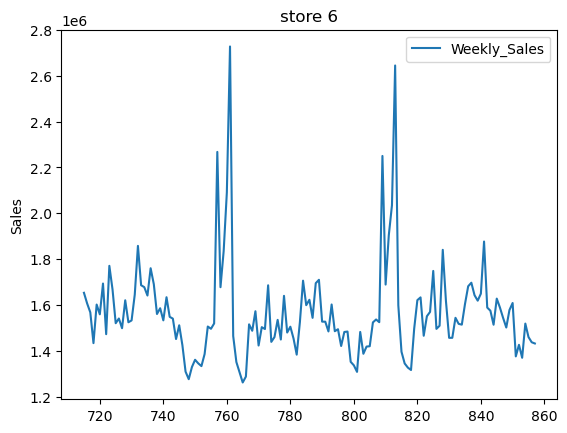

<Figure size 1000x300 with 0 Axes>

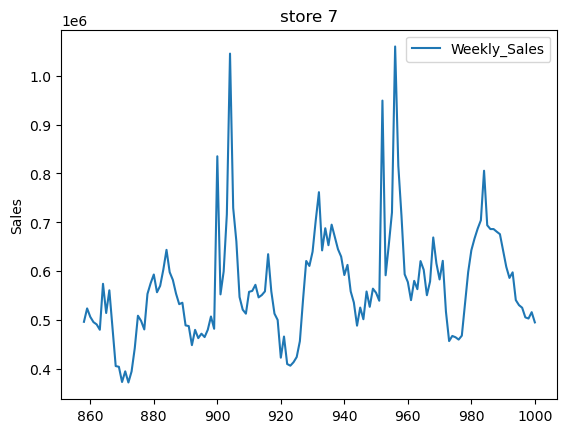

<Figure size 1000x300 with 0 Axes>

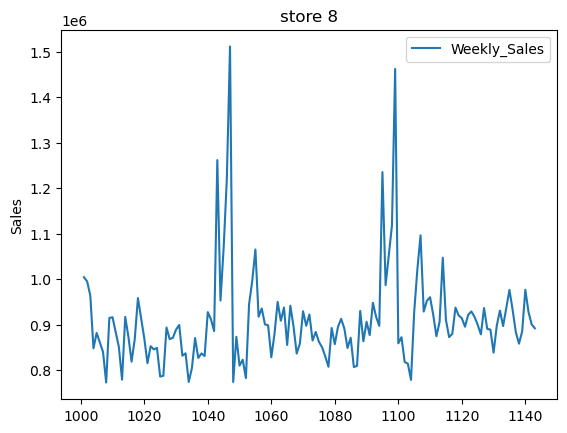

<Figure size 1000x300 with 0 Axes>

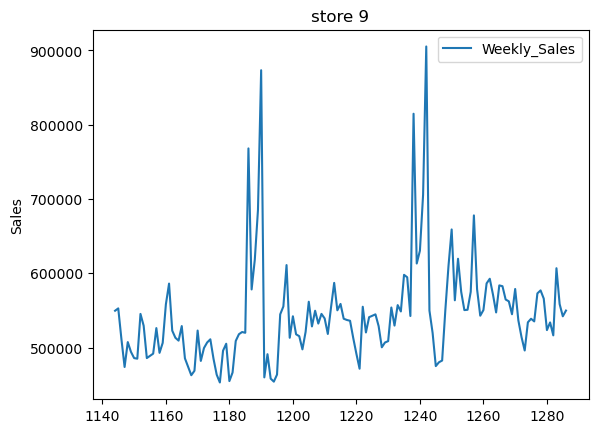

<Figure size 1000x300 with 0 Axes>

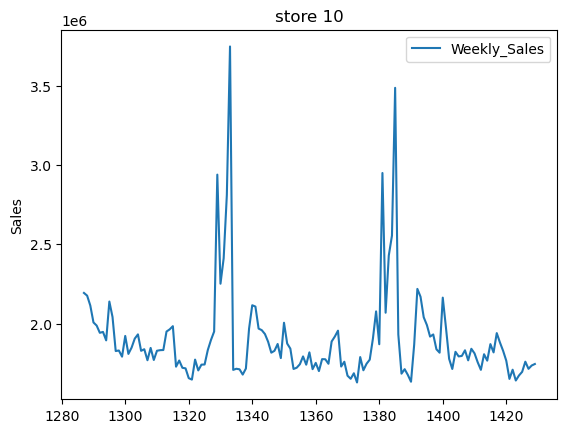

<Figure size 1000x300 with 0 Axes>

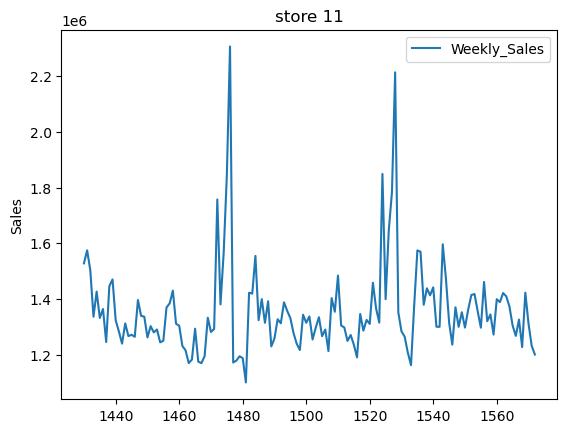

<Figure size 1000x300 with 0 Axes>

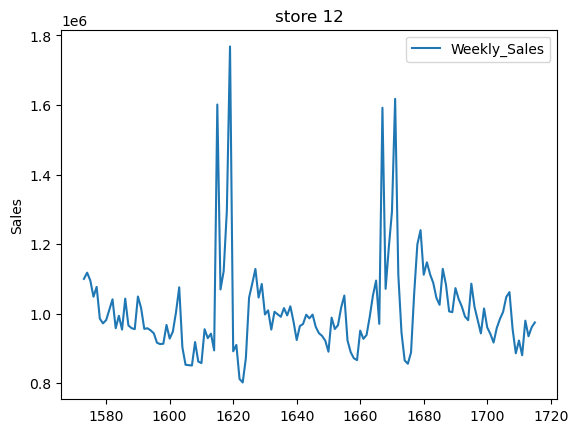

<Figure size 1000x300 with 0 Axes>

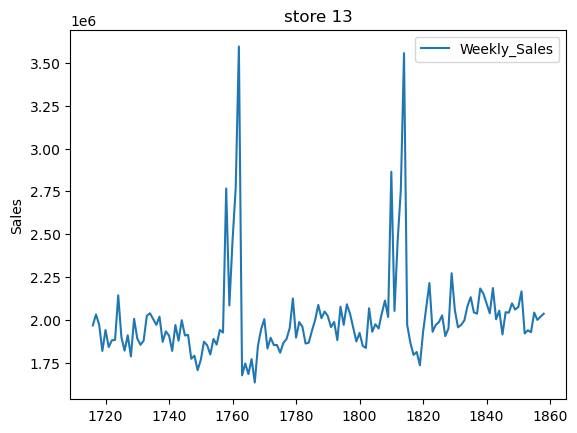

<Figure size 1000x300 with 0 Axes>

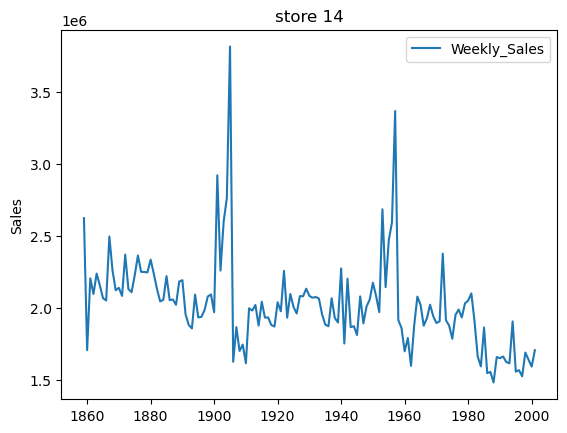

<Figure size 1000x300 with 0 Axes>

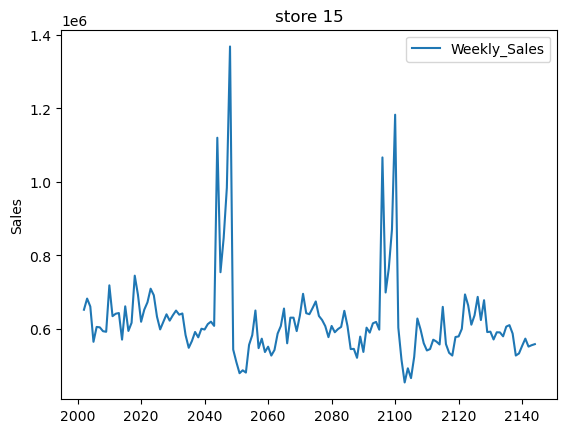

<Figure size 1000x300 with 0 Axes>

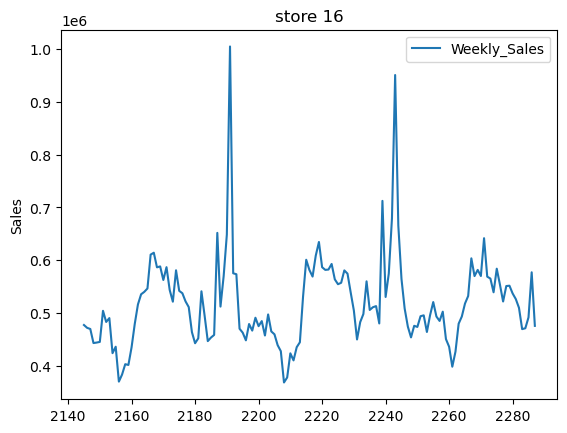

<Figure size 1000x300 with 0 Axes>

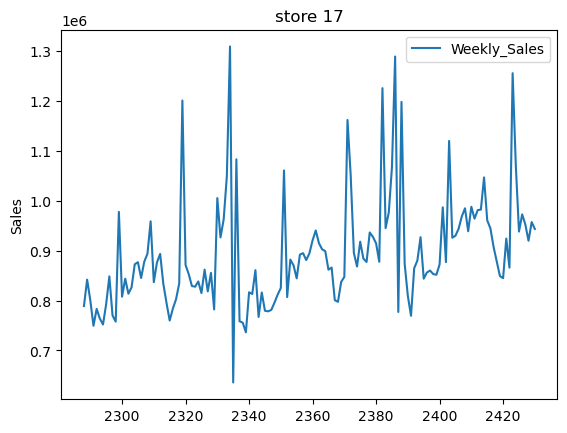

<Figure size 1000x300 with 0 Axes>

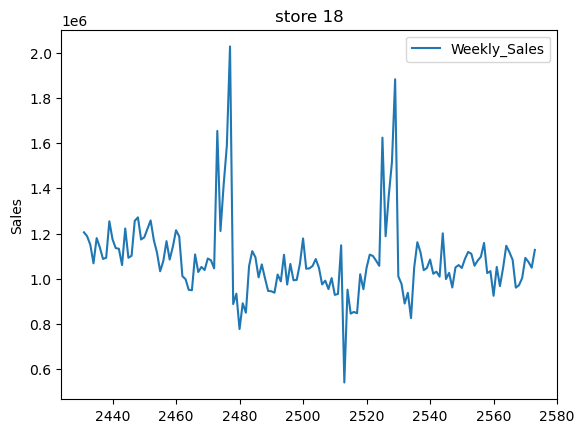

<Figure size 1000x300 with 0 Axes>

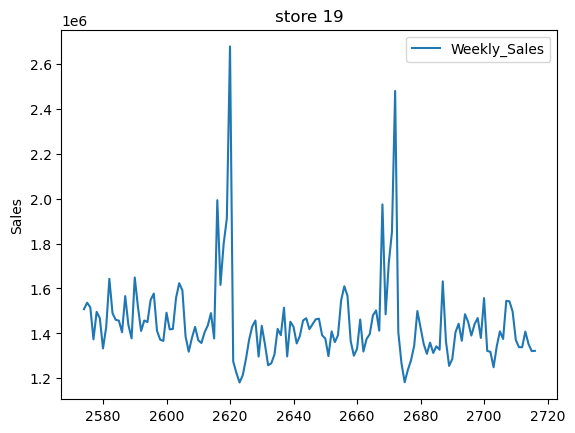

<Figure size 1000x300 with 0 Axes>

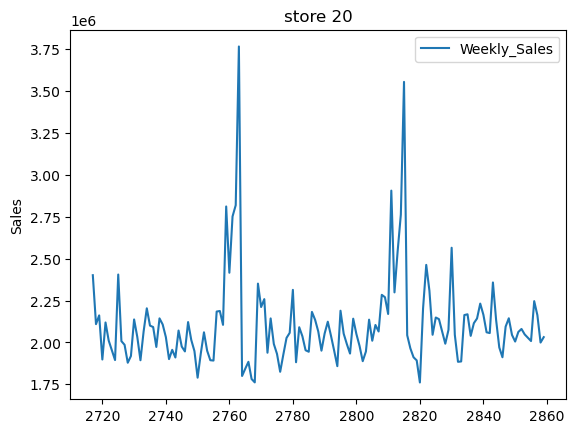

<Figure size 1000x300 with 0 Axes>

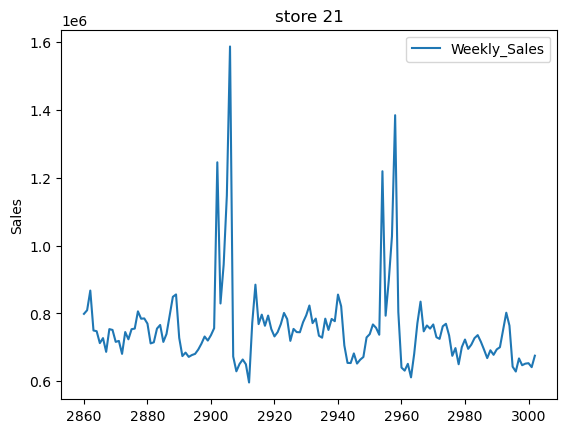

<Figure size 1000x300 with 0 Axes>

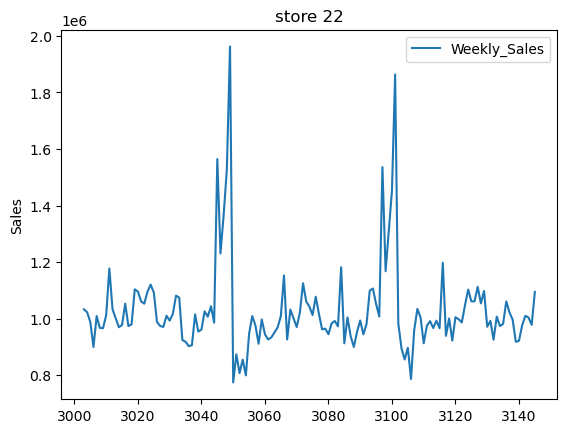

<Figure size 1000x300 with 0 Axes>

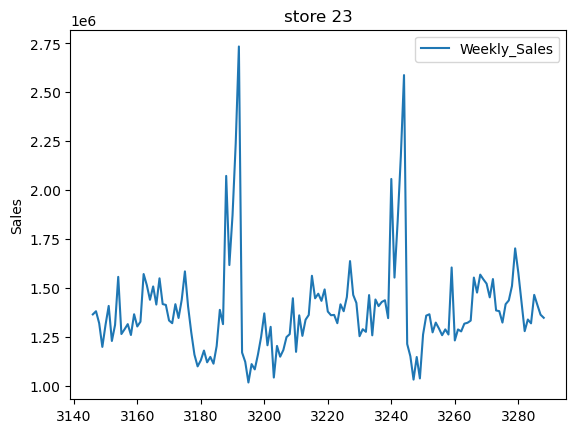

<Figure size 1000x300 with 0 Axes>

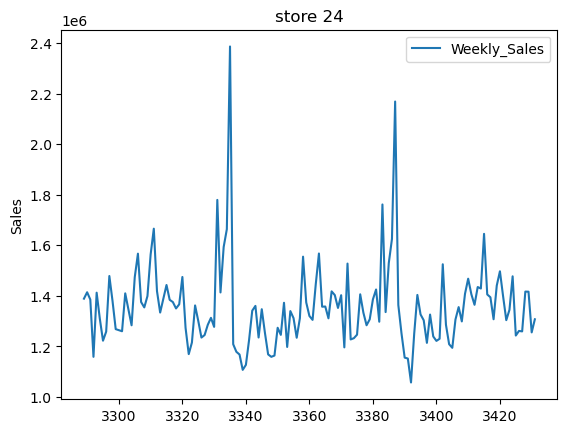

<Figure size 1000x300 with 0 Axes>

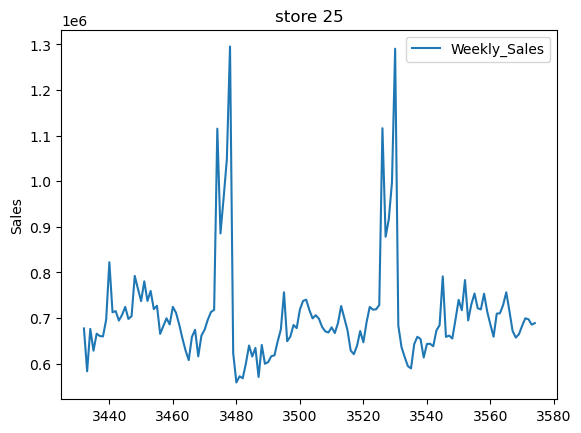

<Figure size 1000x300 with 0 Axes>

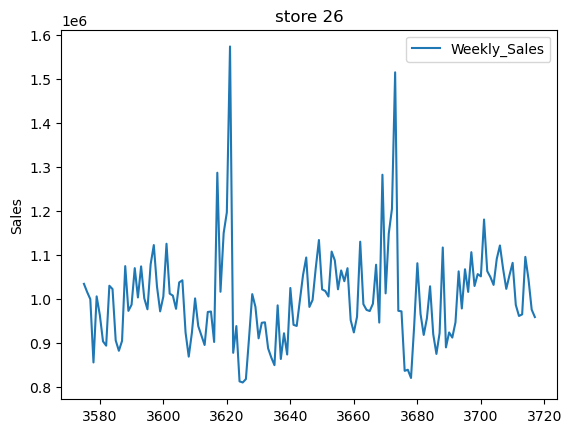

<Figure size 1000x300 with 0 Axes>

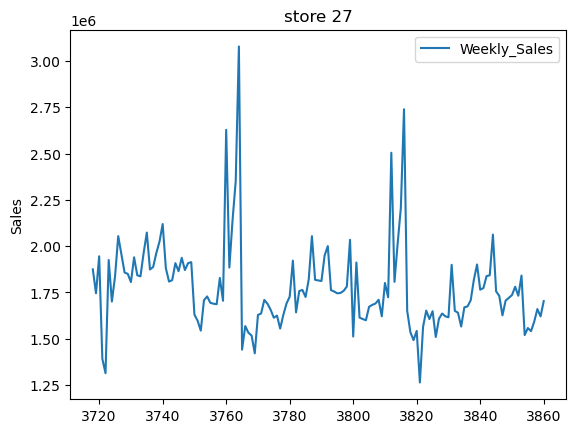

<Figure size 1000x300 with 0 Axes>

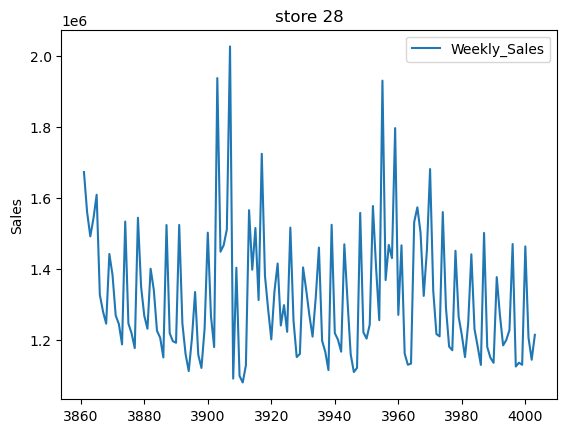

<Figure size 1000x300 with 0 Axes>

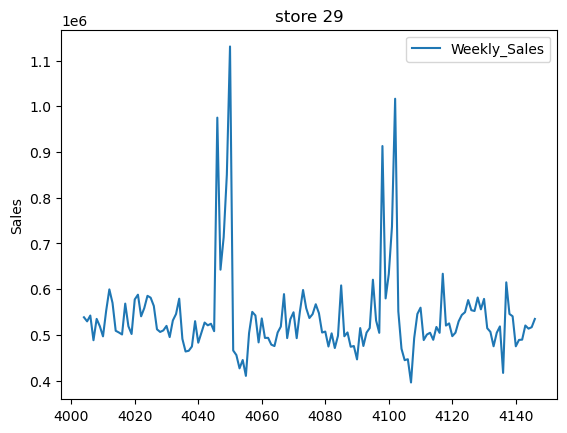

<Figure size 1000x300 with 0 Axes>

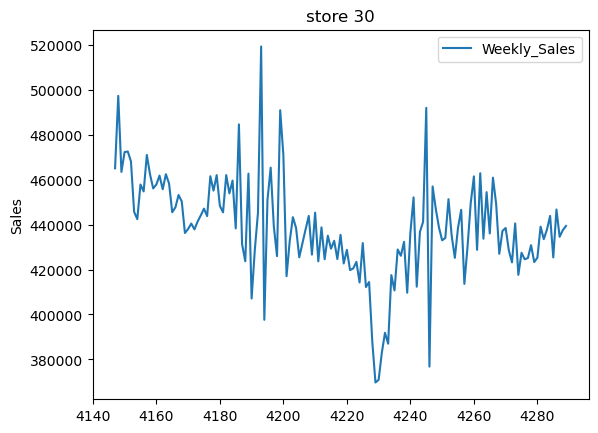

<Figure size 1000x300 with 0 Axes>

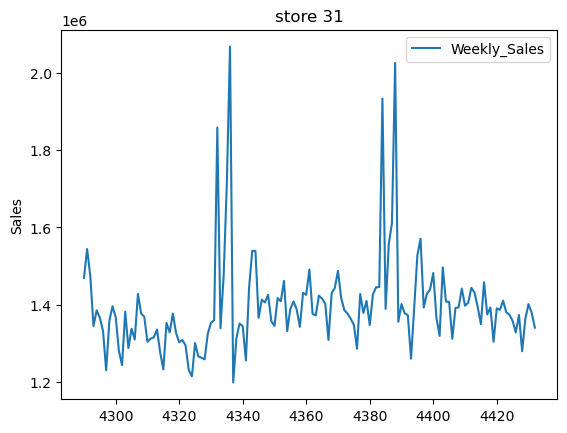

<Figure size 1000x300 with 0 Axes>

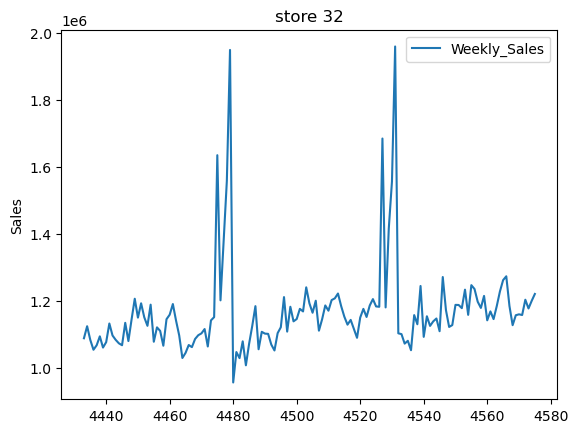

<Figure size 1000x300 with 0 Axes>

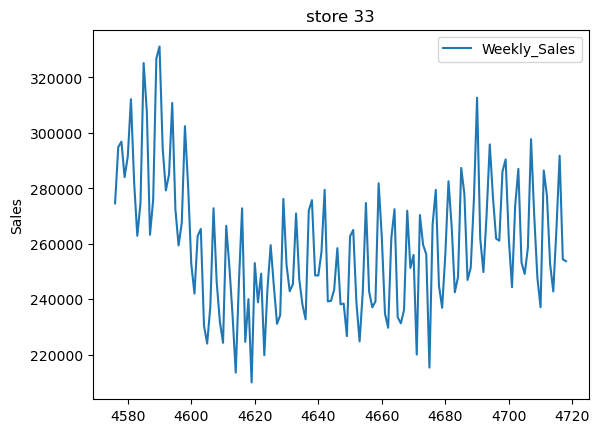

<Figure size 1000x300 with 0 Axes>

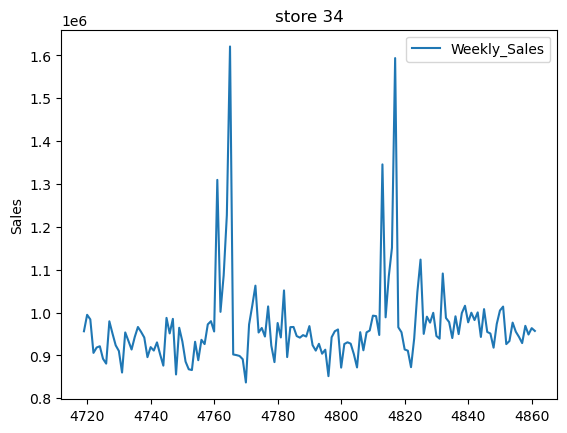

<Figure size 1000x300 with 0 Axes>

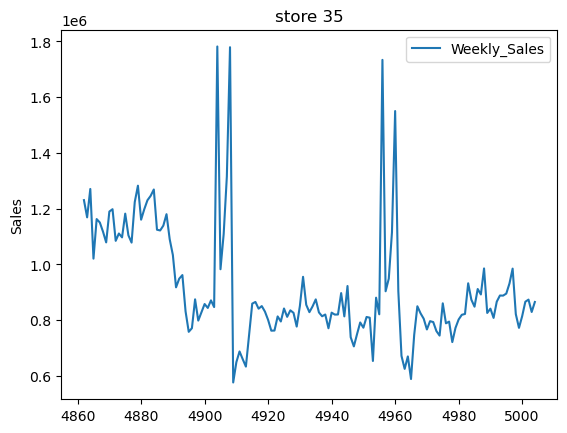

<Figure size 1000x300 with 0 Axes>

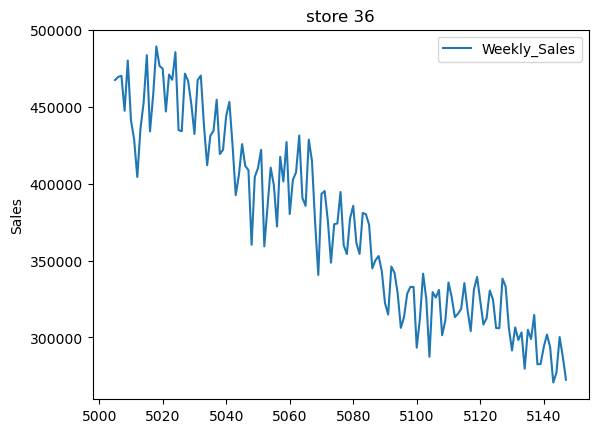

<Figure size 1000x300 with 0 Axes>

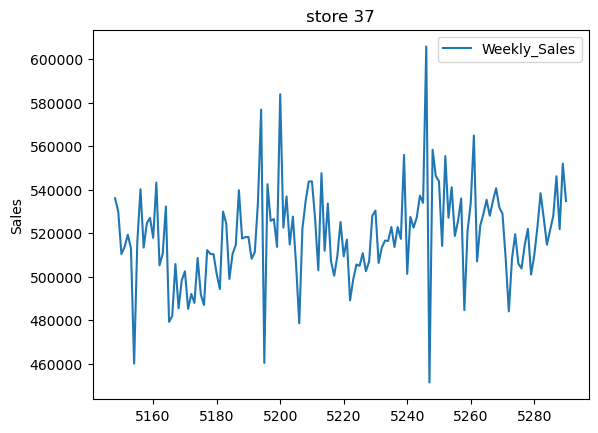

<Figure size 1000x300 with 0 Axes>

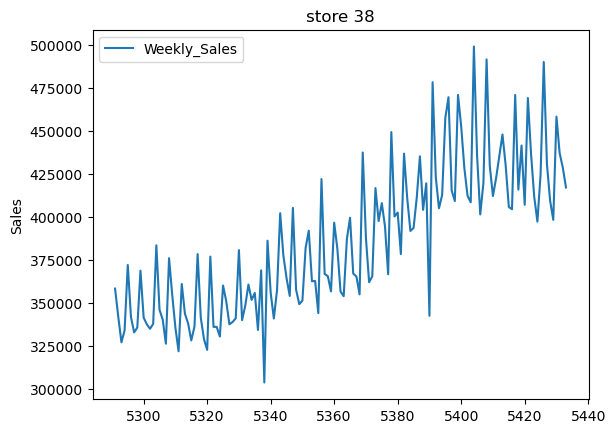

<Figure size 1000x300 with 0 Axes>

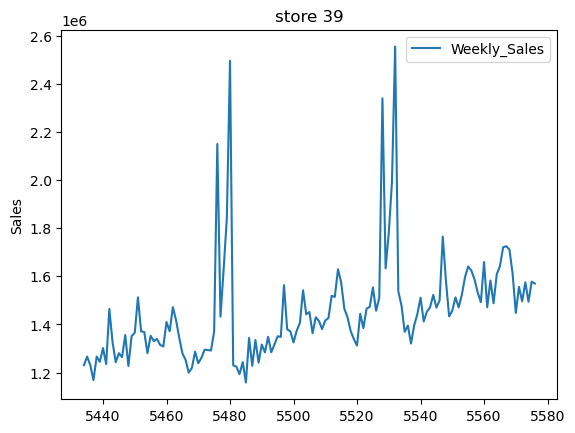

<Figure size 1000x300 with 0 Axes>

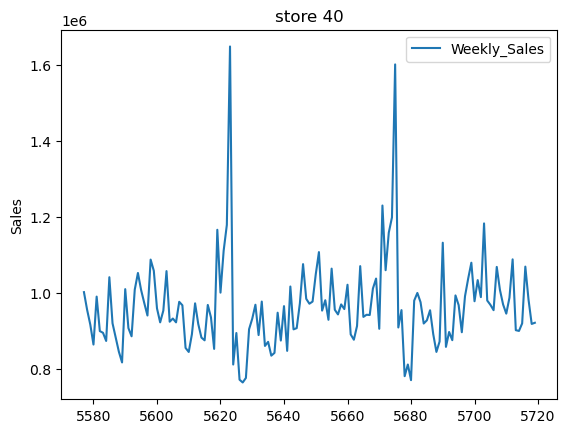

<Figure size 1000x300 with 0 Axes>

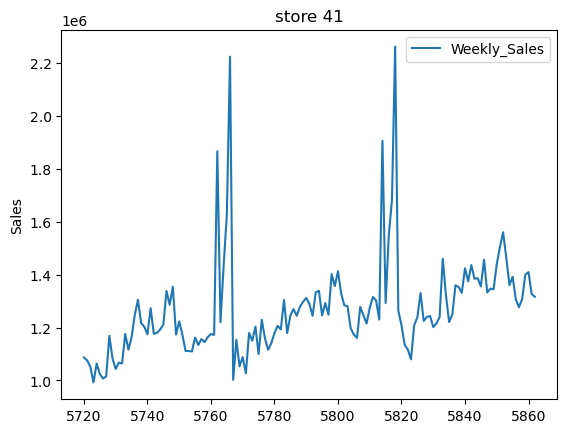

<Figure size 1000x300 with 0 Axes>

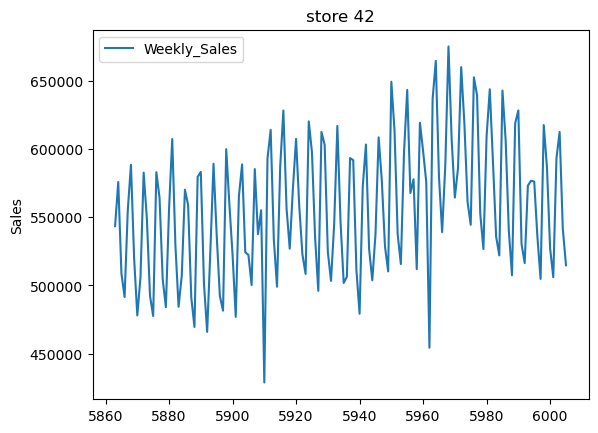

<Figure size 1000x300 with 0 Axes>

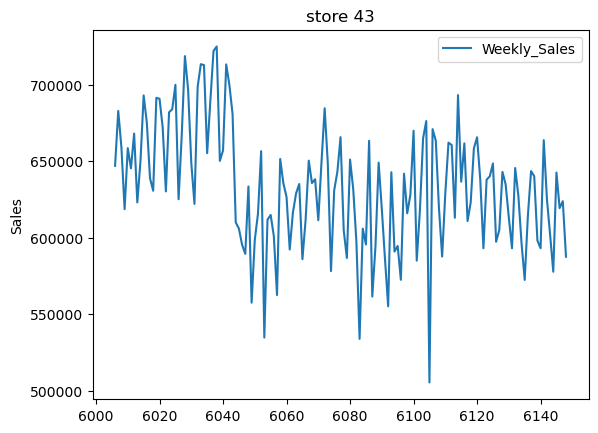

<Figure size 1000x300 with 0 Axes>

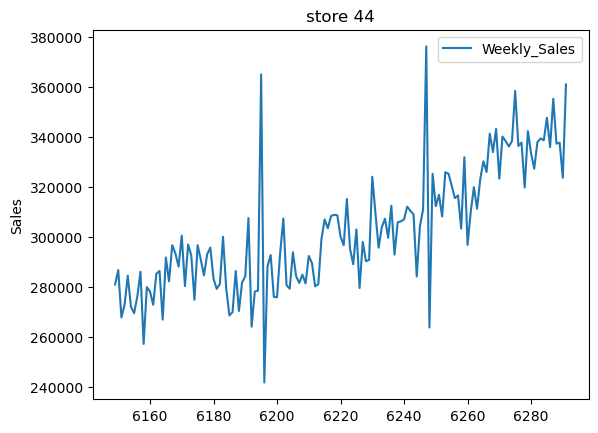

<Figure size 1000x300 with 0 Axes>

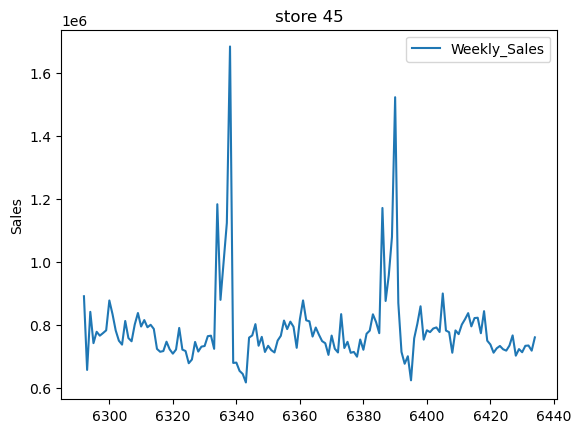

In [48]:
for store,store_df in store_dfs.items():
    plt.figure(figsize=(10,3))
    store_df.plot(y = 'Weekly_Sales',title = f'store {store}')
    plt.ylabel("Sales")
    plt.show()

PERFORMING ADF TEST 
- to check whether that the data is stationary or not.

In [49]:
from statsmodels.tsa.stattools import adfuller

In [50]:
for store,store_df in store_dfs.items():
    result = adfuller(store_df["Weekly_Sales"])

    print(f'{store}ADF Statistic,{result[0]}') #some default value based upon the critial values
    print(f'{store}p-value={result[1]}')
    print(f'{store}Critical Values:')
    print(f'{store}n_lags,{result[2]}')#previous no.of observations used for prediction
    for key,value in result[4].items():
        print(f'{key}:{value:.3f}')
        print()

    if(result[1]>0.05):
        print("The series is not stationary")
    else:
        print("series is stationary")

1ADF Statistic,-5.102186145192285
1p-value=1.3877788330759535e-05
1Critical Values:
1n_lags,4
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
2ADF Statistic,-3.7088625726189153
2p-value=0.003990207089066268
2Critical Values:
2n_lags,6
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
3ADF Statistic,-2.9638677455113234
3p-value=0.03840926179831252
3Critical Values:
3n_lags,6
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
4ADF Statistic,-2.8793819840147146
4p-value=0.04779866223669805
4Critical Values:
4n_lags,6
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
5ADF Statistic,-4.310974424060915
5p-value=0.00042517056141923293
5Critical Values:
5n_lags,4
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
6ADF Statistic,-5.492502135779504
6p-value=2.1594858682169703e-06
6Critical Values:
6n_lags,4
1%:-3.479

5%:-2.883

10%:-2.578

series is stationary
7ADF Statistic,-4.476254338547256
7p-value=0.0002170071890711761
7Critical Values:
7n_lags,7
1%:-3.480

5%:-2.8

DIFFERENCING

33,36,38,43,44 these are the non-stationary stores. So will perform differencing method to make the data of these stores stationary.

In [51]:
for store,store_df in store_dfs.items():
    if store in ['33','34','38','43','44']:
        store_df['diff_sales']= store_df["Weekly_Sales"].diff().fillna(method = 'bfill')

CHECKING STATIONARITY AGAIN 

In [52]:
for store,store_df in store_dfs.items():
    if store in ['33','34','38','43','44']:
        result = adfuller(store_df["diff_sales"])

        print(f'{store}ADF Statistic,{result[0]}') #some default value based upon the critial values
        print(f'{store}p-value={result[1]}')
        print(f'{store}Critical Values:')
        print(f'{store}n_lags,{result[2]}')#previous no.of observations used for prediction
        for key,value in result[4].items():
            print(f'{key}:{value:.3f}')
            print()

    if(result[1]>0.05):
        print(f"store {store} is not stationary")
    else:
        print(f"store {store} is stationary")

store 1 is stationary
store 2 is stationary
store 3 is stationary
store 4 is stationary
store 5 is stationary
store 6 is stationary
store 7 is stationary
store 8 is stationary
store 9 is stationary
store 10 is stationary
store 11 is stationary
store 12 is stationary
store 13 is stationary
store 14 is stationary
store 15 is stationary
store 16 is stationary
store 17 is stationary
store 18 is stationary
store 19 is stationary
store 20 is stationary
store 21 is stationary
store 22 is stationary
store 23 is stationary
store 24 is stationary
store 25 is stationary
store 26 is stationary
store 27 is stationary
store 28 is stationary
store 29 is stationary
store 30 is stationary
store 31 is stationary
store 32 is stationary
store 33 is stationary
store 34 is stationary
store 35 is stationary
store 36 is stationary
store 37 is stationary
store 38 is stationary
store 39 is stationary
store 40 is stationary
store 41 is stationary
store 42 is stationary
store 43 is stationary
store 44 is stationa

INSTALLING PROPHET LIBRARY

In [53]:
!pip install prophet
from prophet import Prophet

Now that our Prophet model has been initialized, we can call its fit method with our DataFrame as input and renaming the column 'Date' as 'ds' and 'Weekly_Sales' as 'y'.

FITTING THE PROPHET MODEL

In [54]:
models = {}
for store,store_df in store_dfs.items():
    store_df1 = store_df.rename(columns = {'Date':'ds','Weekly_Sales':'y'})
    model = Prophet()
    model.fit(store_df1)
    models[store] = model

20:08:55 - cmdstanpy - INFO - Chain [1] start processing
20:08:56 - cmdstanpy - INFO - Chain [1] done processing
20:08:56 - cmdstanpy - INFO - Chain [1] start processing
20:08:56 - cmdstanpy - INFO - Chain [1] done processing
20:08:57 - cmdstanpy - INFO - Chain [1] start processing
20:08:57 - cmdstanpy - INFO - Chain [1] done processing
20:08:57 - cmdstanpy - INFO - Chain [1] start processing
20:08:57 - cmdstanpy - INFO - Chain [1] done processing
20:08:58 - cmdstanpy - INFO - Chain [1] start processing
20:08:58 - cmdstanpy - INFO - Chain [1] done processing
20:08:58 - cmdstanpy - INFO - Chain [1] start processing
20:08:58 - cmdstanpy - INFO - Chain [1] done processing
20:08:59 - cmdstanpy - INFO - Chain [1] start processing
20:08:59 - cmdstanpy - INFO - Chain [1] done processing
20:08:59 - cmdstanpy - INFO - Chain [1] start processing
20:08:59 - cmdstanpy - INFO - Chain [1] done processing
20:08:59 - cmdstanpy - INFO - Chain [1] start processing
20:08:59 - cmdstanpy - INFO - Chain [1]

In order to obtain forecasts of our time series, we must provide Prophet with a
new DataFrame containing a ds column that holds the dates for which we want 
predictions.

Conveniently, we do not have to concern ourselves with manually creating this
DataFrame, as Prophet provides the make_future_dataframe helper function.

MAKING PREDICTIONS

In [55]:
for store,model in models.items():
    future = model.make_future_dataframe(periods = 12*7,freq ='D')
    forecast = model.predict(future)

In [56]:
data.tail()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
6430,45,2012-09-28,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,2012-05-10,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,2012-12-10,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,2012-10-19,718125.53,0,56.47,3.969,192.330854,8.667
6434,45,2012-10-26,760281.43,0,58.85,3.882,192.308899,8.667


As we can see in the above code that in our original dataset we had data till
october 2012. And now in new dataframe forecast we instructed Prophet to 
generate 84 datestamps(12 weeks) in the future.

Prophet returns a large DataFrame with many interesting columns, but we subset
our output to the columns most relevant to forecasting. These are:

ds: the datestamp now consist of the forecasted value also.  
yhat: the forecasted value of our metric (in Statistics, yhat is a notation 
      traditionally used to represent the predicted values of a value y)
yhat_lower: the lower bound of our forecasts.
yhat_upper: the upper bound of our forecasts.

In [57]:
forecast.tail()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
222,2013-02-28,775219.678939,606174.527220,845814.525940,775211.748192,775228.590677,-47242.428154,-47242.428154,-47242.428154,-21838.953253,-21838.953253,-21838.953253,-25403.474901,-25403.474901,-25403.474901,0.0,0.0,0.0,727977.250785
223,2013-03-01,775209.775883,651939.445727,890329.234199,775201.723767,775218.912386,-11419.775487,-11419.775487,-11419.775487,11100.799892,11100.799892,11100.799892,-22520.575379,-22520.575379,-22520.575379,0.0,0.0,0.0,763790.000396
224,2013-03-02,775199.872827,605941.938356,841945.529487,775191.613720,775209.111121,-48058.767203,-48058.767203,-48058.767203,-29024.679547,-29024.679547,-29024.679547,-19034.087656,-19034.087656,-19034.087656,0.0,0.0,0.0,727141.105624
225,2013-03-03,775189.969771,679032.618202,934298.419006,775181.480912,775199.315600,29739.880799,29739.880799,29739.880799,44861.995155,44861.995155,44861.995155,-15122.114357,-15122.114357,-15122.114357,0.0,0.0,0.0,804929.850570
226,2013-03-04,775180.066715,672283.533930,921036.330246,775171.354721,775189.606805,22295.556411,22295.556411,22295.556411,33265.402839,33265.402839,33265.402839,-10969.846429,-10969.846429,-10969.846429,0.0,0.0,0.0,797475.623126


In [58]:
predictions = pd.DataFrame(columns=['store','ds','yhat'])

for store,store_df in store_dfs.items():
    store_pred = forecast[['ds','yhat']].tail(12*7)
    store_pred['store']= store
    predictions = pd.concat([predictions,store_pred], axis = 0)

# FORECASTING SALES

PLOTTING PREDICTION GRAPH FOR NEXT 12 WEEKS

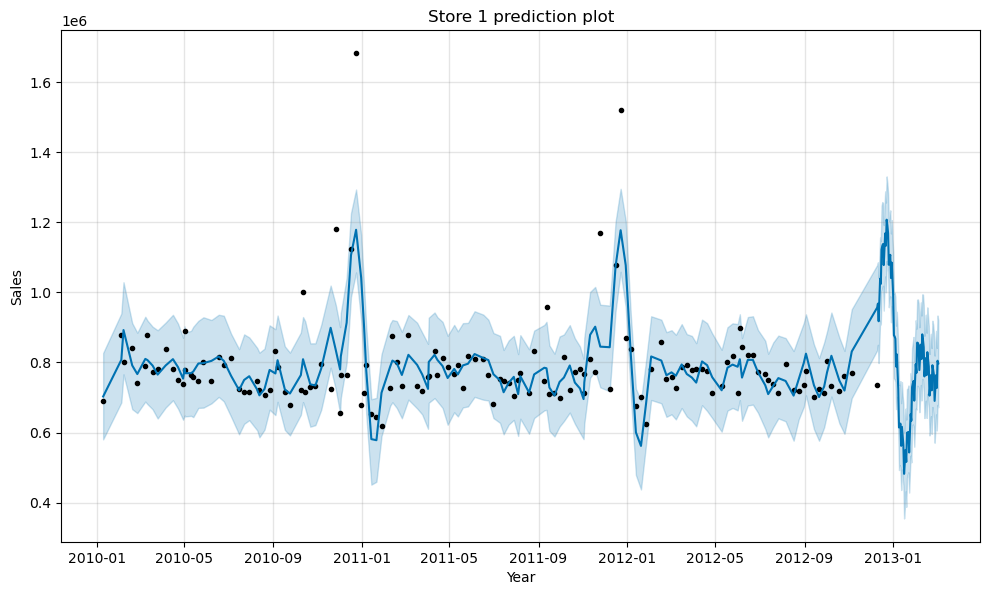

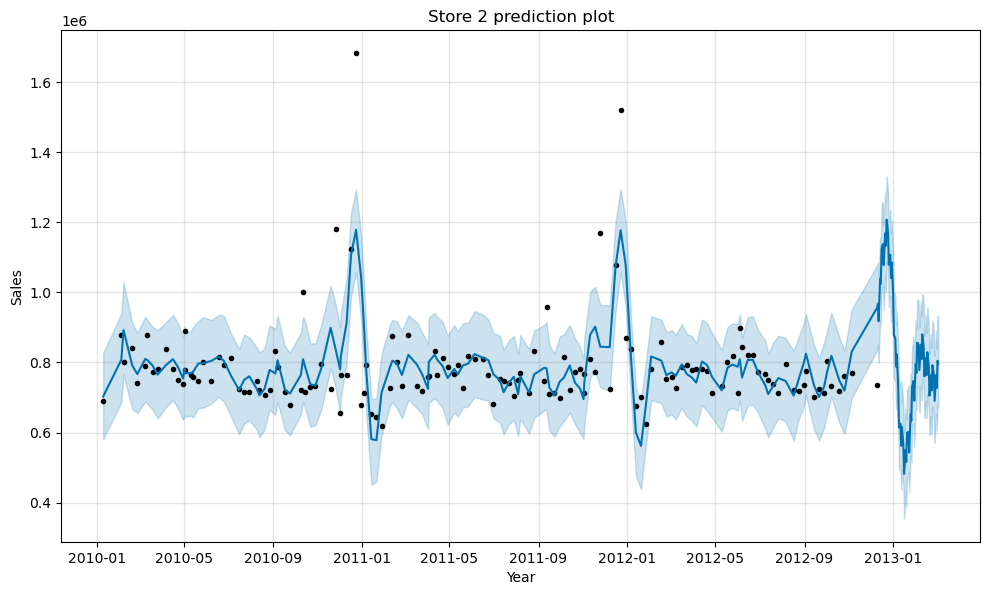

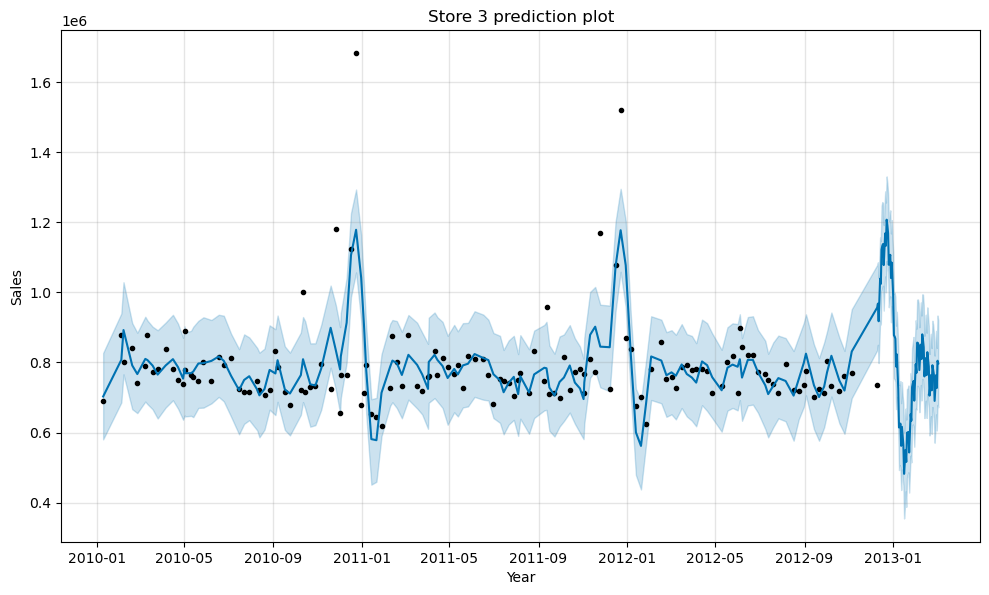

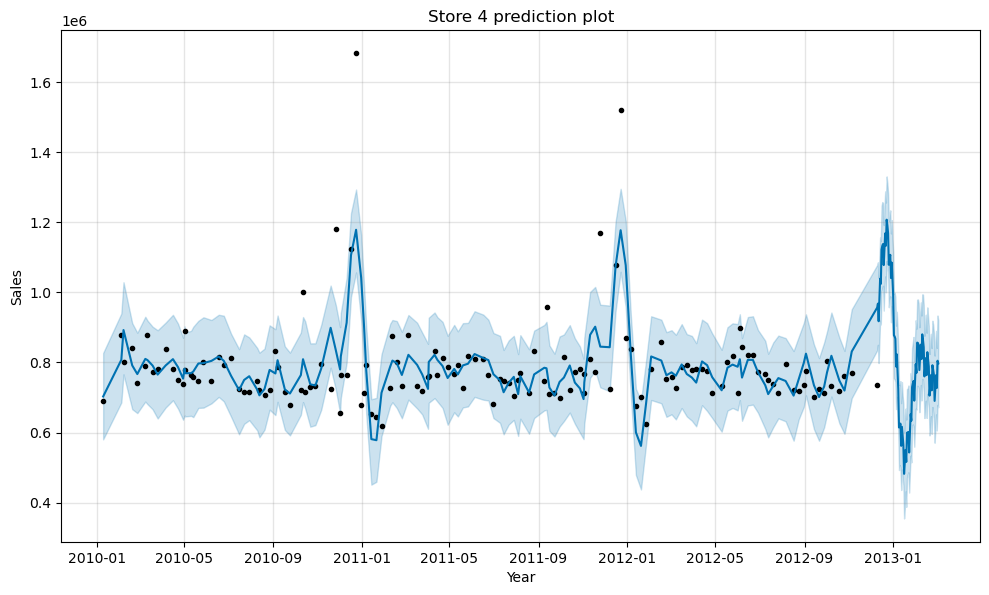

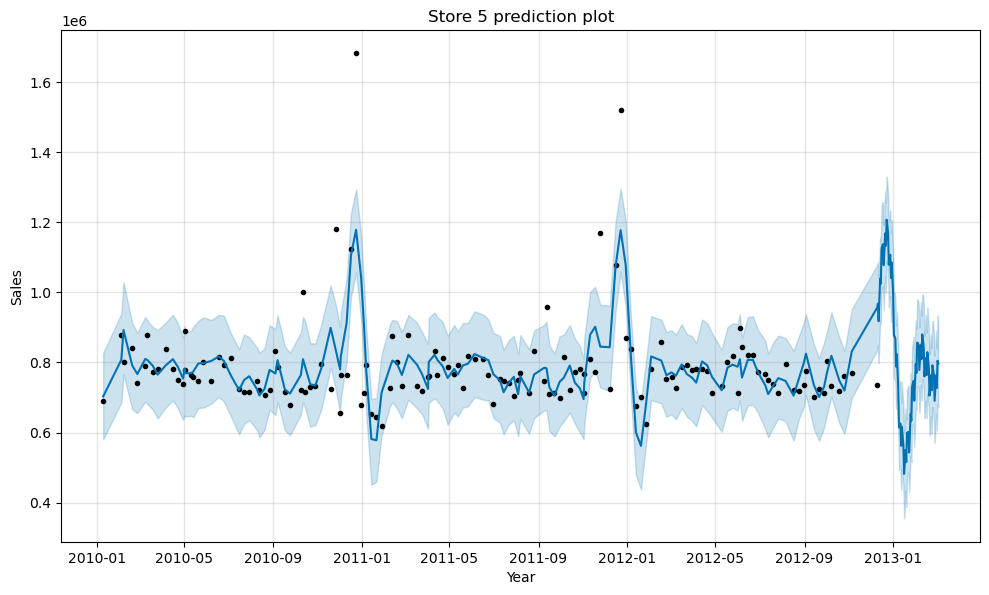

...

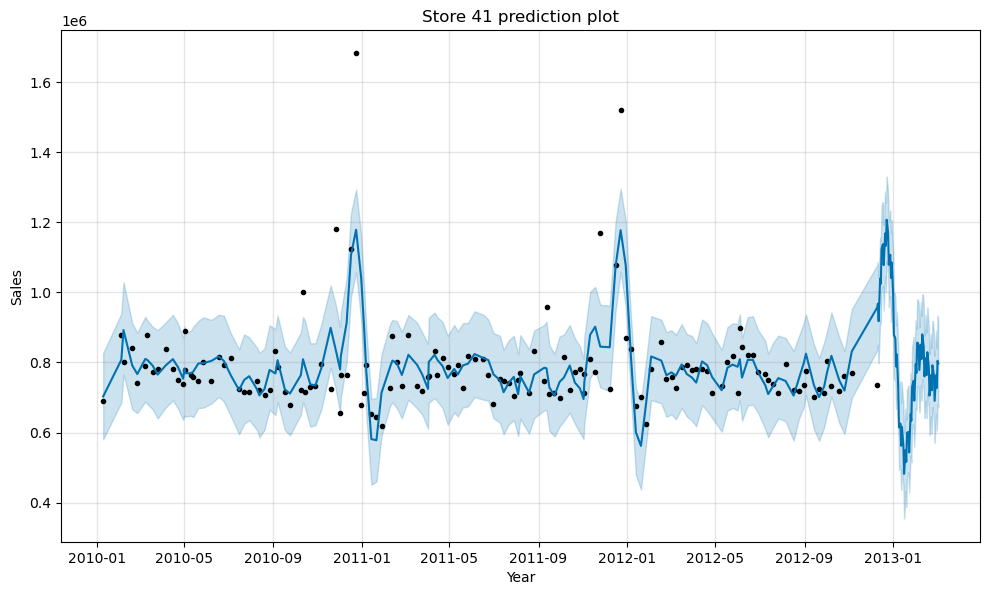

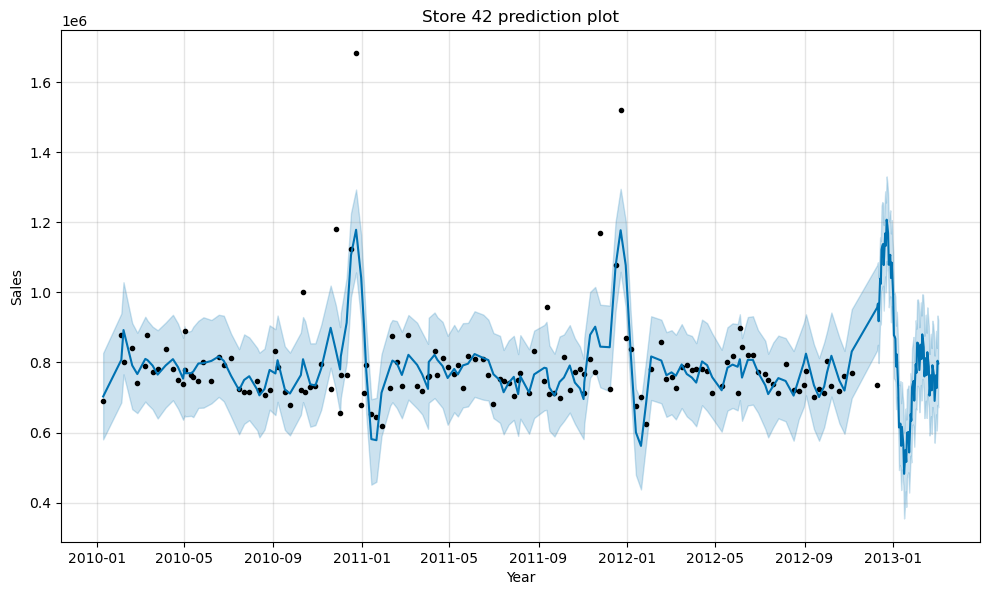

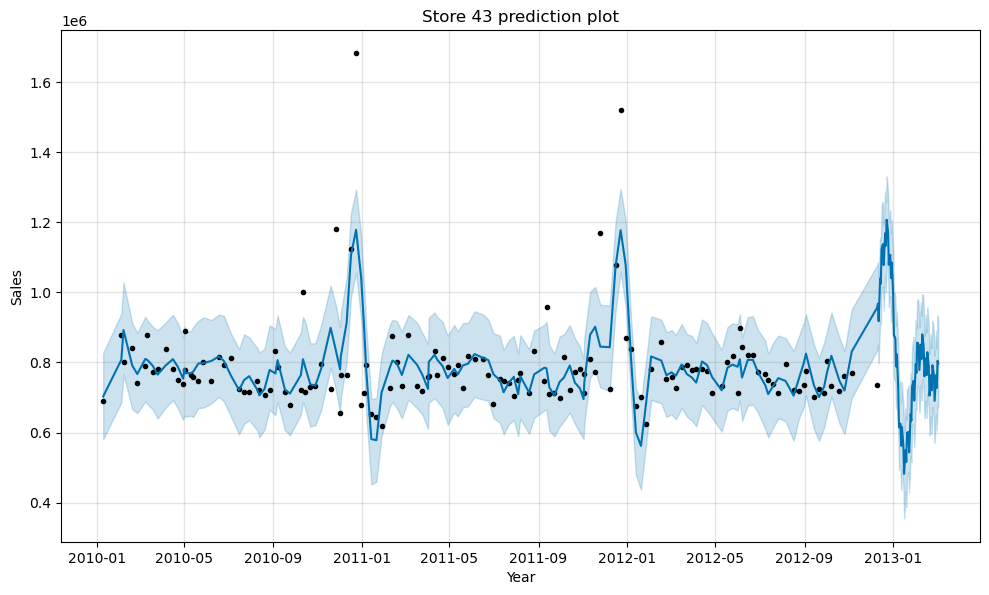

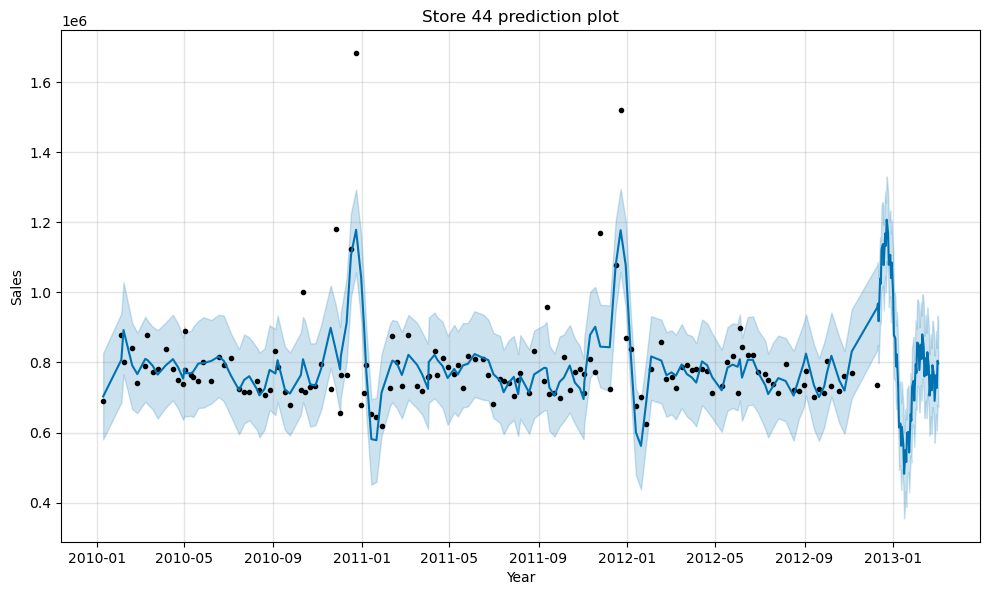

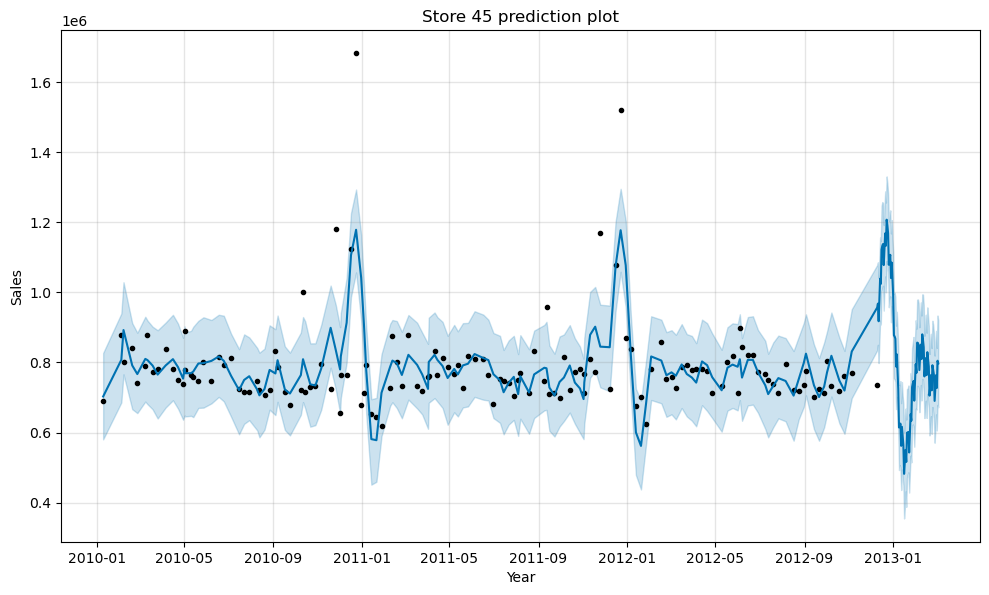

In [59]:
for store,store_df in store_dfs.items():
    fig = model.plot(forecast)
    plt.xlabel('Year')
    plt.ylabel('Sales')
    plt.title(f'Store {store} prediction plot')

Here in this above plots the black points that you see are real data , the blue
line is the projection of prediction and the light shaded part around the 
points is the uncertainty intervals . As it is clearly shown in the above prediction plots that there
is a sudden decrease in the graph as we entered in new year i.e 2013 same as we
assumed in the previous years graph as well. The sales always increase in the 
last months of the year and then a sudden fall in each stores sales.

VISUALIZING THE COMPONENTS OF EACH STORE

One other particularly strong feature of Prophet is its ability to return the 
components of our forecasts.
This can help reveal how daily, weekly and yearly patterns of the time series 
contribute to the overall forecasted values.

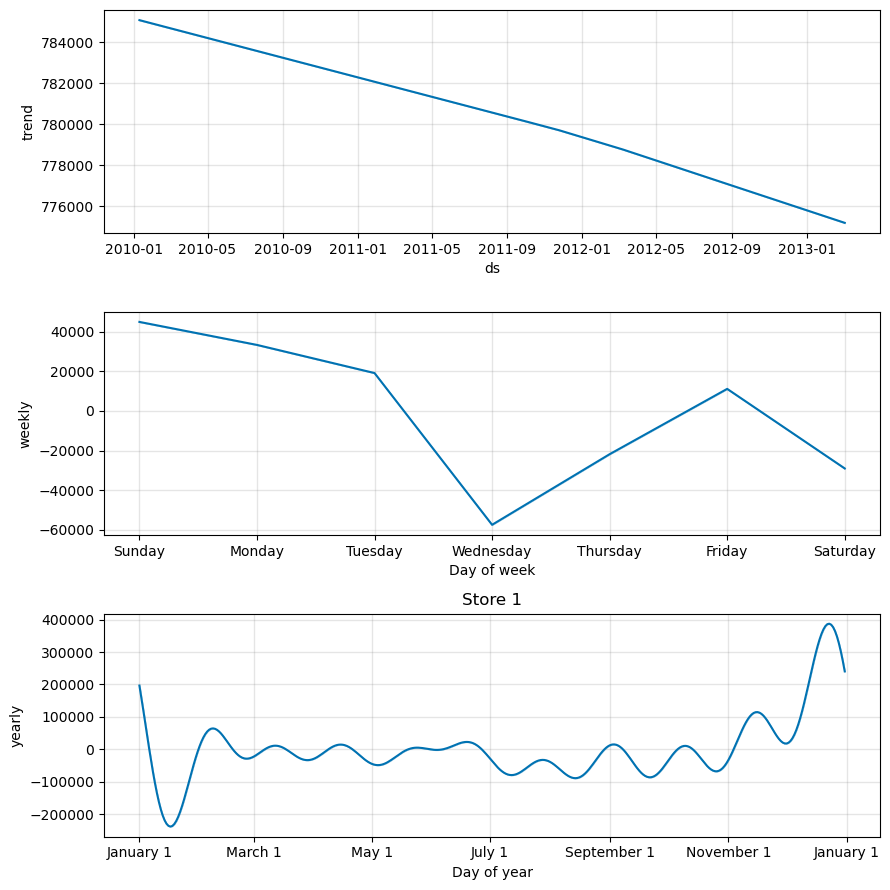

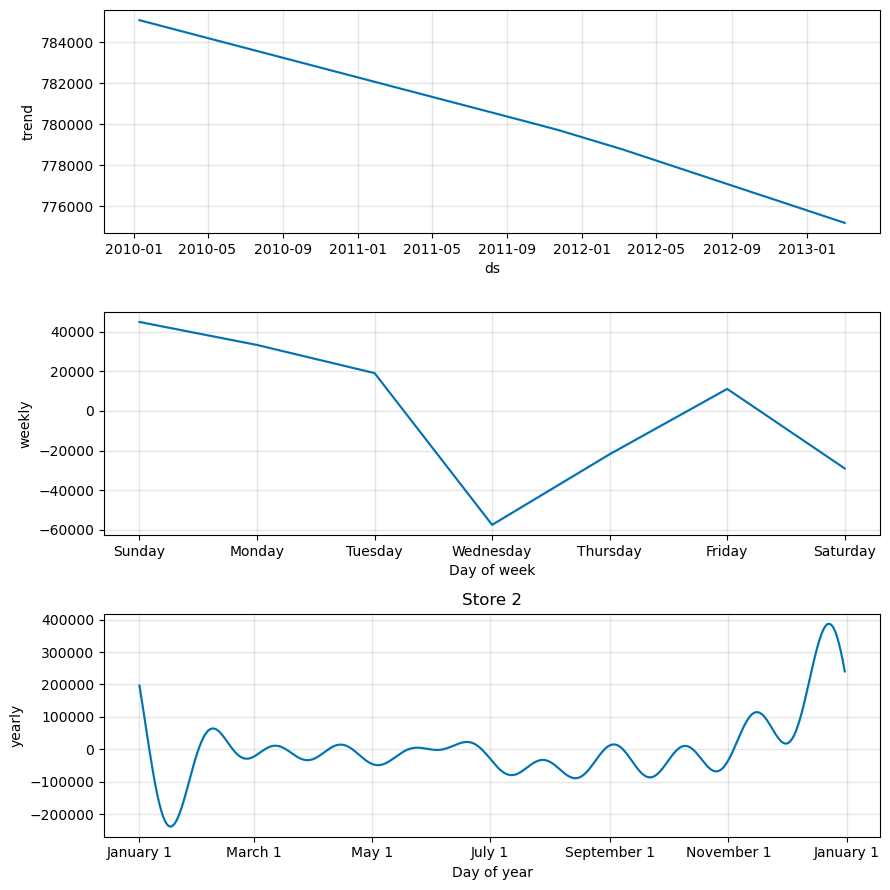

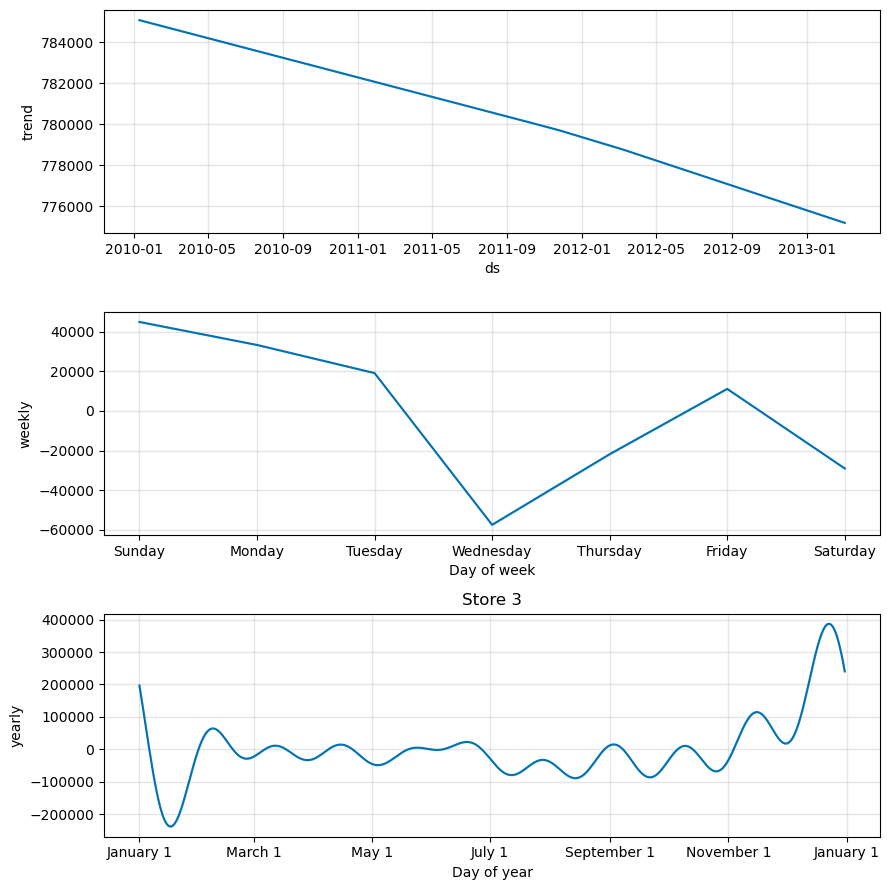

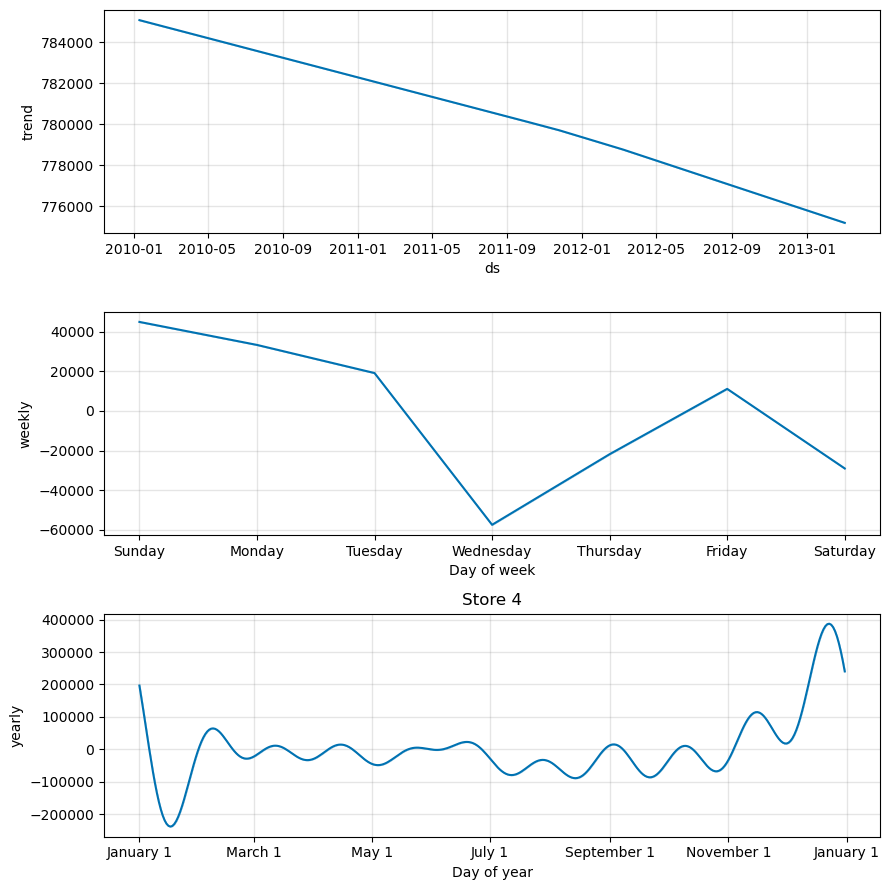

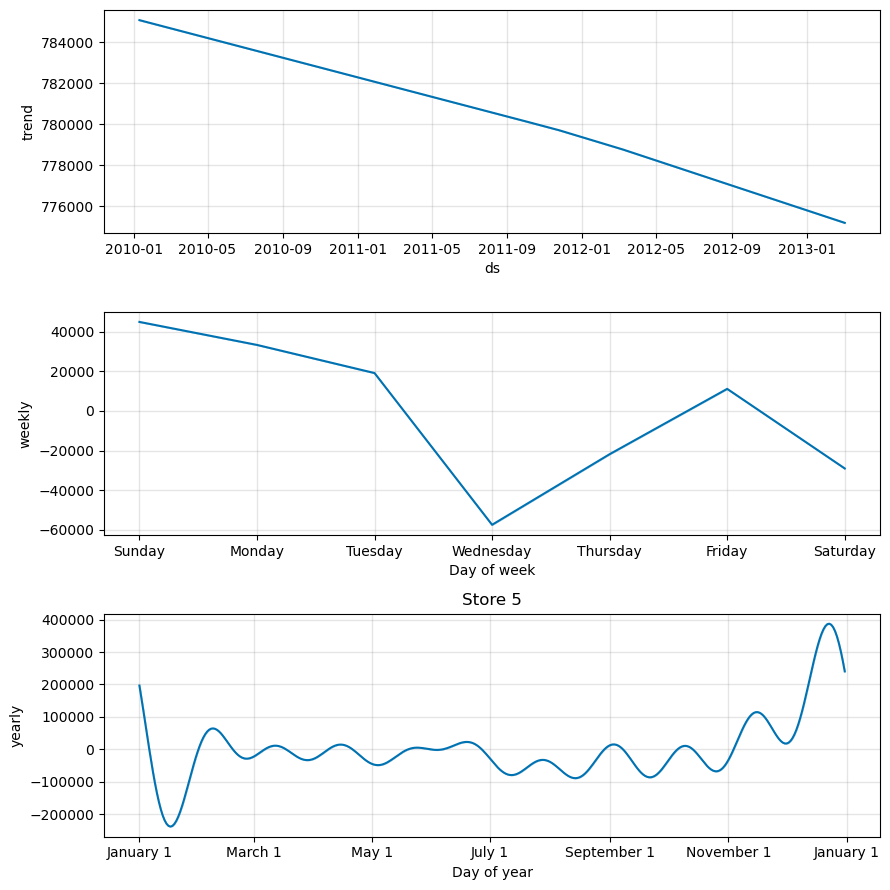

...

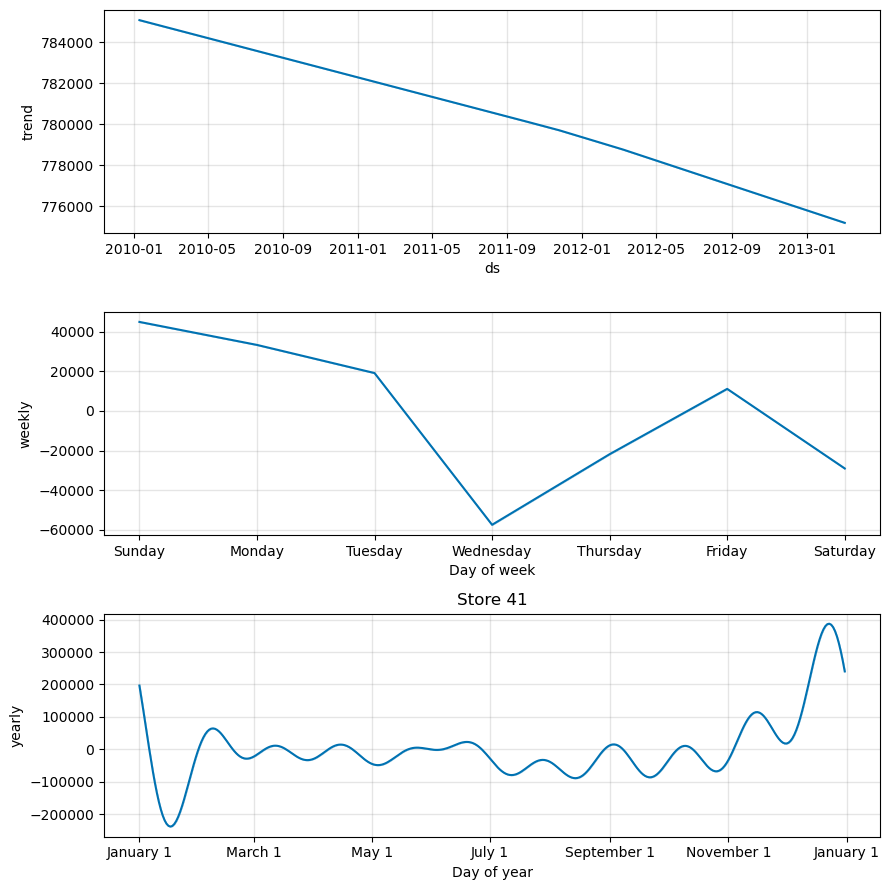

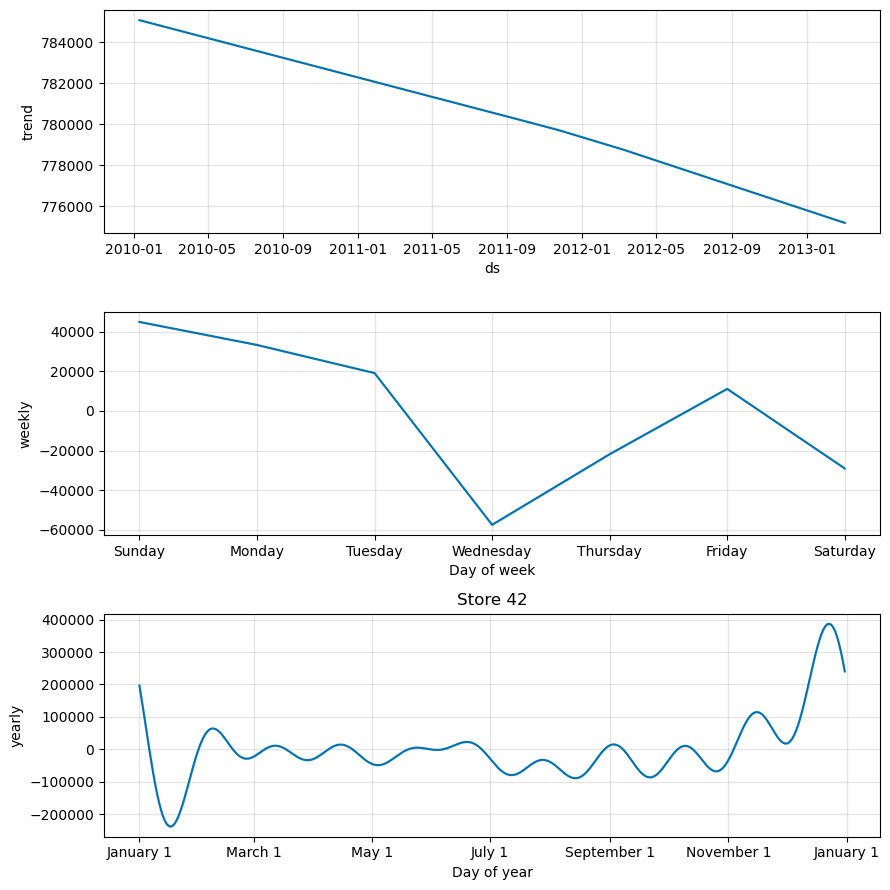

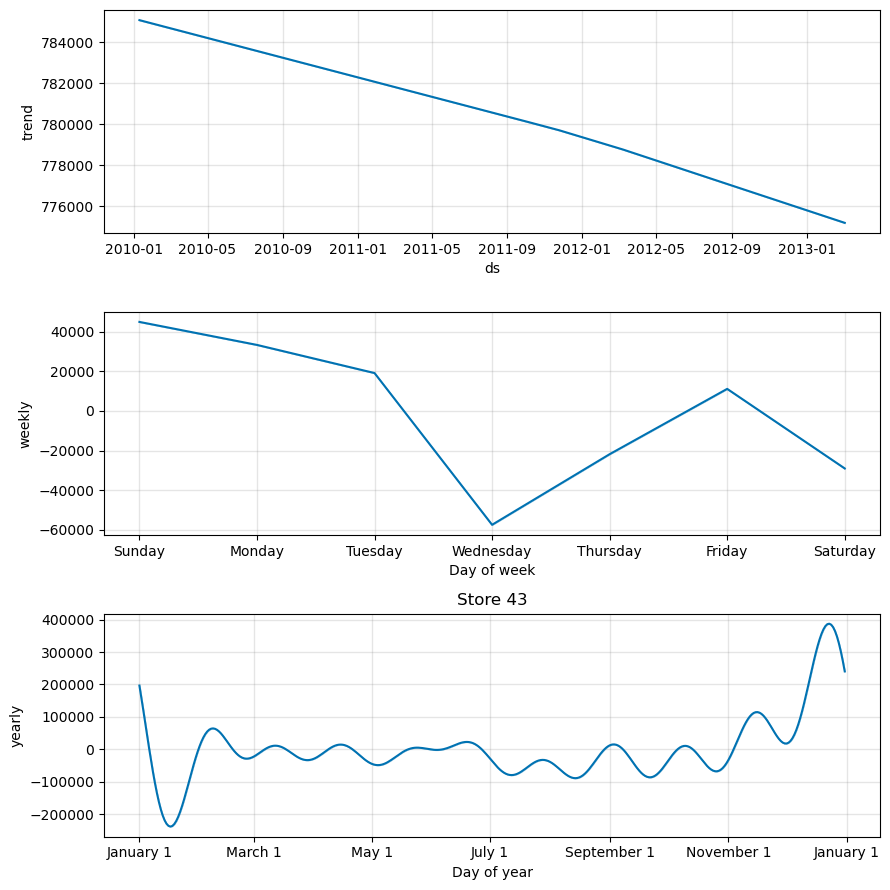

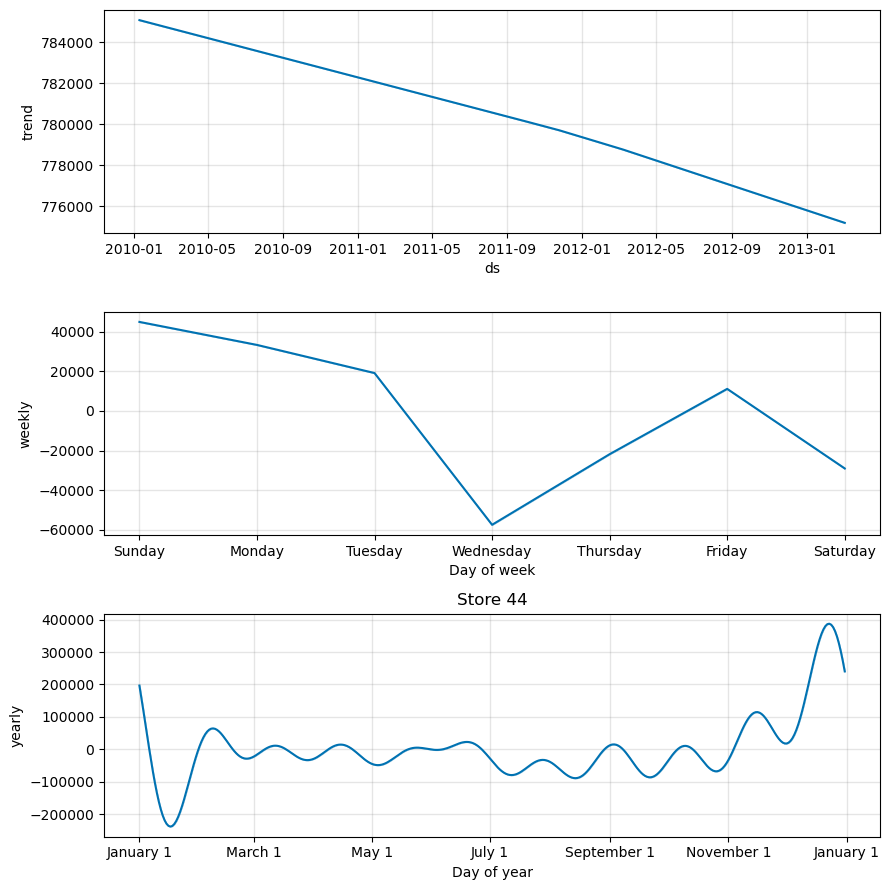

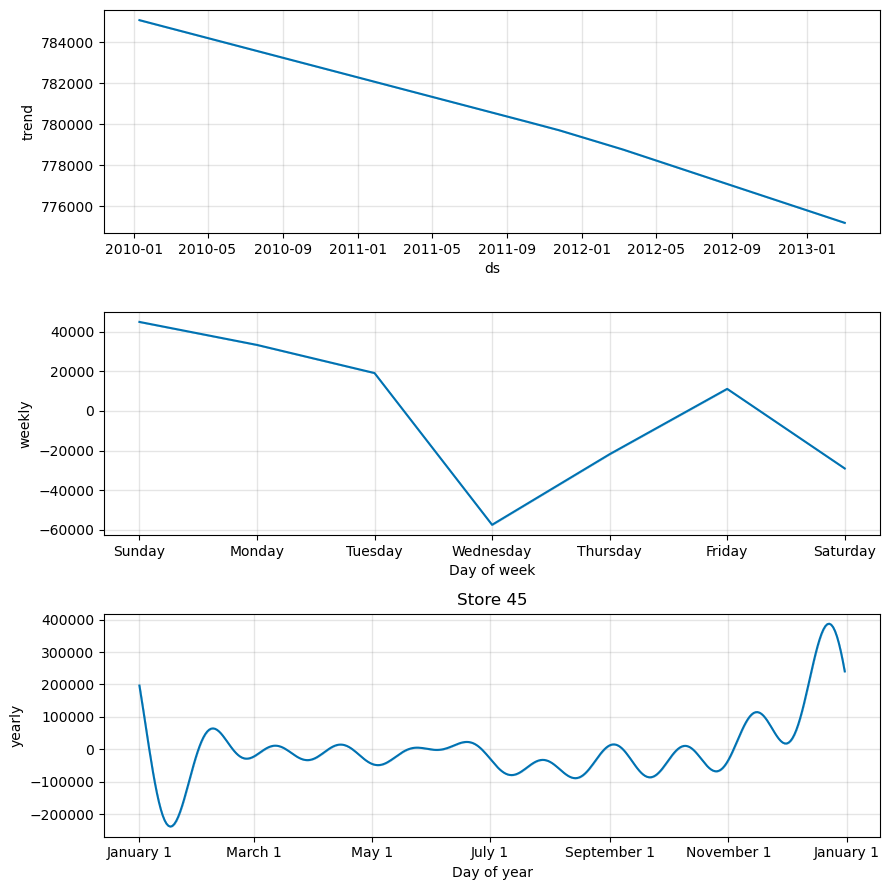

In [60]:
for store,store_df in store_dfs.items():
    model.plot_components(forecast)
    plt.title(f'Store {store}')
    plt.tight_layout()

:- The above plot provides interesting insights.
:- The first plot shows that the monthly volume of a particular store's sales
    has been fluctuating at a linear pace all months.
    There is a increase after November which indicates that the most traffic
    occurs during the holiday month of christmas and new year, then again there
    is a fall in mid weeks of january.
:- The second plot is showing the downward trend throughout the year.
:- The third plot  highlights the fact that the weekly count of customers peaks 
    on Sunday and falls on Wednesday.

PERFORMING CROSS-VALIDATION

:- In order for us to find out how our model performs and know if we are making
progress we need some kind of validation. Prophet includes functionality for
time series cross validation to measure forecast error using historical data.
:- This cross validation procedure can be done automatically for a range of 
    historical cutoffs using the cross_validation function. We specify,
    horizon - the forecast horizon
    initial - the size of the initial training period
    period - the spacing between cutoff dates
By default, the initial training period is set to three times the horizon,
and cutoffs (period) are made every half a horizon.
:- The resulting dataframe can now be used to compute error measures of yhat
    vs. y.

Here we do cross-validation to assess prediction performance on a horizon of 84
days, starting with 226 days of training data in the first cutoff and then
making predictions every 42 days.

In [61]:
from prophet.diagnostics import cross_validation

for store,store_df in store_dfs.items():
    data2 = cross_validation(model, initial='226 days' , period='42 days' ,
                             horizon='84 days')
    data2.head()

Seasonality has period of 365.25 days which is larger than initial window. Consider increasing initial.


  0%|          | 0/18 [00:00<?, ?it/s]

20:10:33 - cmdstanpy - INFO - Chain [1] start processing
20:10:33 - cmdstanpy - INFO - Chain [1] done processing
20:10:34 - cmdstanpy - INFO - Chain [1] start processing
20:10:34 - cmdstanpy - INFO - Chain [1] done processing
20:10:35 - cmdstanpy - INFO - Chain [1] start processing
20:10:35 - cmdstanpy - INFO - Chain [1] done processing
20:10:36 - cmdstanpy - INFO - Chain [1] start processing
20:10:36 - cmdstanpy - INFO - Chain [1] done processing
20:10:36 - cmdstanpy - INFO - Chain [1] start processing
20:10:37 - cmdstanpy - INFO - Chain [1] done processing
20:10:37 - cmdstanpy - INFO - Chain [1] start processing
20:10:38 - cmdstanpy - INFO - Chain [1] done processing
20:10:38 - cmdstanpy - INFO - Chain [1] start processing
20:10:39 - cmdstanpy - INFO - Chain [1] done processing
20:10:39 - cmdstanpy - INFO - Chain [1] start processing
20:10:40 - cmdstanpy - INFO - Chain [1] done processing
20:10:40 - cmdstanpy - INFO - Chain [1] start processing
20:10:40 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:10:45 - cmdstanpy - INFO - Chain [1] start processing
20:10:46 - cmdstanpy - INFO - Chain [1] done processing
20:10:46 - cmdstanpy - INFO - Chain [1] start processing
20:10:46 - cmdstanpy - INFO - Chain [1] done processing
20:10:47 - cmdstanpy - INFO - Chain [1] start processing
20:10:47 - cmdstanpy - INFO - Chain [1] done processing
20:10:48 - cmdstanpy - INFO - Chain [1] start processing
20:10:48 - cmdstanpy - INFO - Chain [1] done processing
20:10:48 - cmdstanpy - INFO - Chain [1] start processing
20:10:49 - cmdstanpy - INFO - Chain [1] done processing
20:10:49 - cmdstanpy - INFO - Chain [1] start processing
20:10:50 - cmdstanpy - INFO - Chain [1] done processing
20:10:50 - cmdstanpy - INFO - Chain [1] start processing
20:10:51 - cmdstanpy - INFO - Chain [1] done processing
20:10:51 - cmdstanpy - INFO - Chain [1] start processing
20:10:51 - cmdstanpy - INFO - Chain [1] done processing
20:10:52 - cmdstanpy - INFO - Chain [1] start processing
20:10:53 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:10:58 - cmdstanpy - INFO - Chain [1] start processing
20:10:58 - cmdstanpy - INFO - Chain [1] done processing
20:10:59 - cmdstanpy - INFO - Chain [1] start processing
20:10:59 - cmdstanpy - INFO - Chain [1] done processing
20:10:59 - cmdstanpy - INFO - Chain [1] start processing
20:11:00 - cmdstanpy - INFO - Chain [1] done processing
20:11:00 - cmdstanpy - INFO - Chain [1] start processing
20:11:00 - cmdstanpy - INFO - Chain [1] done processing
20:11:01 - cmdstanpy - INFO - Chain [1] start processing
20:11:01 - cmdstanpy - INFO - Chain [1] done processing
20:11:01 - cmdstanpy - INFO - Chain [1] start processing
20:11:02 - cmdstanpy - INFO - Chain [1] done processing
20:11:02 - cmdstanpy - INFO - Chain [1] start processing
20:11:03 - cmdstanpy - INFO - Chain [1] done processing
20:11:03 - cmdstanpy - INFO - Chain [1] start processing
20:11:03 - cmdstanpy - INFO - Chain [1] done processing
20:11:04 - cmdstanpy - INFO - Chain [1] start processing
20:11:04 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:11:10 - cmdstanpy - INFO - Chain [1] start processing
20:11:10 - cmdstanpy - INFO - Chain [1] done processing
20:11:10 - cmdstanpy - INFO - Chain [1] start processing
20:11:11 - cmdstanpy - INFO - Chain [1] done processing
20:11:11 - cmdstanpy - INFO - Chain [1] start processing
20:11:11 - cmdstanpy - INFO - Chain [1] done processing
20:11:12 - cmdstanpy - INFO - Chain [1] start processing
20:11:12 - cmdstanpy - INFO - Chain [1] done processing
20:11:12 - cmdstanpy - INFO - Chain [1] start processing
20:11:13 - cmdstanpy - INFO - Chain [1] done processing
20:11:13 - cmdstanpy - INFO - Chain [1] start processing
20:11:14 - cmdstanpy - INFO - Chain [1] done processing
20:11:15 - cmdstanpy - INFO - Chain [1] start processing
20:11:15 - cmdstanpy - INFO - Chain [1] done processing
20:11:15 - cmdstanpy - INFO - Chain [1] start processing
20:11:16 - cmdstanpy - INFO - Chain [1] done processing
20:11:16 - cmdstanpy - INFO - Chain [1] start processing
20:11:17 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:11:23 - cmdstanpy - INFO - Chain [1] start processing
20:11:23 - cmdstanpy - INFO - Chain [1] done processing
20:11:23 - cmdstanpy - INFO - Chain [1] start processing
20:11:24 - cmdstanpy - INFO - Chain [1] done processing
20:11:24 - cmdstanpy - INFO - Chain [1] start processing
20:11:25 - cmdstanpy - INFO - Chain [1] done processing
20:11:25 - cmdstanpy - INFO - Chain [1] start processing
20:11:25 - cmdstanpy - INFO - Chain [1] done processing
20:11:26 - cmdstanpy - INFO - Chain [1] start processing
20:11:26 - cmdstanpy - INFO - Chain [1] done processing
20:11:26 - cmdstanpy - INFO - Chain [1] start processing
20:11:27 - cmdstanpy - INFO - Chain [1] done processing
20:11:28 - cmdstanpy - INFO - Chain [1] start processing
20:11:28 - cmdstanpy - INFO - Chain [1] done processing
20:11:28 - cmdstanpy - INFO - Chain [1] start processing
20:11:29 - cmdstanpy - INFO - Chain [1] done processing
20:11:29 - cmdstanpy - INFO - Chain [1] start processing
20:11:30 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:11:36 - cmdstanpy - INFO - Chain [1] start processing
20:11:36 - cmdstanpy - INFO - Chain [1] done processing
20:11:36 - cmdstanpy - INFO - Chain [1] start processing
20:11:37 - cmdstanpy - INFO - Chain [1] done processing
20:11:37 - cmdstanpy - INFO - Chain [1] start processing
20:11:38 - cmdstanpy - INFO - Chain [1] done processing
20:11:38 - cmdstanpy - INFO - Chain [1] start processing
20:11:38 - cmdstanpy - INFO - Chain [1] done processing
20:11:38 - cmdstanpy - INFO - Chain [1] start processing
20:11:39 - cmdstanpy - INFO - Chain [1] done processing
20:11:39 - cmdstanpy - INFO - Chain [1] start processing
20:11:40 - cmdstanpy - INFO - Chain [1] done processing
20:11:40 - cmdstanpy - INFO - Chain [1] start processing
20:11:40 - cmdstanpy - INFO - Chain [1] done processing
20:11:41 - cmdstanpy - INFO - Chain [1] start processing
20:11:41 - cmdstanpy - INFO - Chain [1] done processing
20:11:42 - cmdstanpy - INFO - Chain [1] start processing
20:11:42 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:11:48 - cmdstanpy - INFO - Chain [1] start processing
20:11:48 - cmdstanpy - INFO - Chain [1] done processing
20:11:49 - cmdstanpy - INFO - Chain [1] start processing
20:11:49 - cmdstanpy - INFO - Chain [1] done processing
20:11:50 - cmdstanpy - INFO - Chain [1] start processing
20:11:50 - cmdstanpy - INFO - Chain [1] done processing
20:11:51 - cmdstanpy - INFO - Chain [1] start processing
20:11:51 - cmdstanpy - INFO - Chain [1] done processing
20:11:51 - cmdstanpy - INFO - Chain [1] start processing
20:11:52 - cmdstanpy - INFO - Chain [1] done processing
20:11:52 - cmdstanpy - INFO - Chain [1] start processing
20:11:53 - cmdstanpy - INFO - Chain [1] done processing
20:11:53 - cmdstanpy - INFO - Chain [1] start processing
20:11:54 - cmdstanpy - INFO - Chain [1] done processing
20:11:54 - cmdstanpy - INFO - Chain [1] start processing
20:11:55 - cmdstanpy - INFO - Chain [1] done processing
20:11:55 - cmdstanpy - INFO - Chain [1] start processing
20:11:56 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:12:01 - cmdstanpy - INFO - Chain [1] start processing
20:12:01 - cmdstanpy - INFO - Chain [1] done processing
20:12:02 - cmdstanpy - INFO - Chain [1] start processing
20:12:02 - cmdstanpy - INFO - Chain [1] done processing
20:12:02 - cmdstanpy - INFO - Chain [1] start processing
20:12:03 - cmdstanpy - INFO - Chain [1] done processing
20:12:03 - cmdstanpy - INFO - Chain [1] start processing
20:12:03 - cmdstanpy - INFO - Chain [1] done processing
20:12:04 - cmdstanpy - INFO - Chain [1] start processing
20:12:04 - cmdstanpy - INFO - Chain [1] done processing
20:12:05 - cmdstanpy - INFO - Chain [1] start processing
20:12:05 - cmdstanpy - INFO - Chain [1] done processing
20:12:05 - cmdstanpy - INFO - Chain [1] start processing
20:12:06 - cmdstanpy - INFO - Chain [1] done processing
20:12:06 - cmdstanpy - INFO - Chain [1] start processing
20:12:07 - cmdstanpy - INFO - Chain [1] done processing
20:12:07 - cmdstanpy - INFO - Chain [1] start processing
20:12:08 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:12:13 - cmdstanpy - INFO - Chain [1] start processing
20:12:13 - cmdstanpy - INFO - Chain [1] done processing
20:12:13 - cmdstanpy - INFO - Chain [1] start processing
20:12:14 - cmdstanpy - INFO - Chain [1] done processing
20:12:14 - cmdstanpy - INFO - Chain [1] start processing
20:12:15 - cmdstanpy - INFO - Chain [1] done processing
20:12:15 - cmdstanpy - INFO - Chain [1] start processing
20:12:16 - cmdstanpy - INFO - Chain [1] done processing
20:12:16 - cmdstanpy - INFO - Chain [1] start processing
20:12:17 - cmdstanpy - INFO - Chain [1] done processing
20:12:17 - cmdstanpy - INFO - Chain [1] start processing
20:12:18 - cmdstanpy - INFO - Chain [1] done processing
20:12:18 - cmdstanpy - INFO - Chain [1] start processing
20:12:18 - cmdstanpy - INFO - Chain [1] done processing
20:12:19 - cmdstanpy - INFO - Chain [1] start processing
20:12:19 - cmdstanpy - INFO - Chain [1] done processing
20:12:19 - cmdstanpy - INFO - Chain [1] start processing
20:12:20 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:12:26 - cmdstanpy - INFO - Chain [1] start processing
20:12:26 - cmdstanpy - INFO - Chain [1] done processing
20:12:27 - cmdstanpy - INFO - Chain [1] start processing
20:12:27 - cmdstanpy - INFO - Chain [1] done processing
20:12:27 - cmdstanpy - INFO - Chain [1] start processing
20:12:28 - cmdstanpy - INFO - Chain [1] done processing
20:12:28 - cmdstanpy - INFO - Chain [1] start processing
20:12:28 - cmdstanpy - INFO - Chain [1] done processing
20:12:29 - cmdstanpy - INFO - Chain [1] start processing
20:12:29 - cmdstanpy - INFO - Chain [1] done processing
20:12:30 - cmdstanpy - INFO - Chain [1] start processing
20:12:30 - cmdstanpy - INFO - Chain [1] done processing
20:12:31 - cmdstanpy - INFO - Chain [1] start processing
20:12:31 - cmdstanpy - INFO - Chain [1] done processing
20:12:31 - cmdstanpy - INFO - Chain [1] start processing
20:12:32 - cmdstanpy - INFO - Chain [1] done processing
20:12:32 - cmdstanpy - INFO - Chain [1] start processing
20:12:33 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:12:38 - cmdstanpy - INFO - Chain [1] start processing
20:12:38 - cmdstanpy - INFO - Chain [1] done processing
20:12:38 - cmdstanpy - INFO - Chain [1] start processing
20:12:39 - cmdstanpy - INFO - Chain [1] done processing
20:12:39 - cmdstanpy - INFO - Chain [1] start processing
20:12:40 - cmdstanpy - INFO - Chain [1] done processing
20:12:40 - cmdstanpy - INFO - Chain [1] start processing
20:12:40 - cmdstanpy - INFO - Chain [1] done processing
20:12:40 - cmdstanpy - INFO - Chain [1] start processing
20:12:41 - cmdstanpy - INFO - Chain [1] done processing
20:12:41 - cmdstanpy - INFO - Chain [1] start processing
20:12:42 - cmdstanpy - INFO - Chain [1] done processing
20:12:42 - cmdstanpy - INFO - Chain [1] start processing
20:12:43 - cmdstanpy - INFO - Chain [1] done processing
20:12:43 - cmdstanpy - INFO - Chain [1] start processing
20:12:43 - cmdstanpy - INFO - Chain [1] done processing
20:12:44 - cmdstanpy - INFO - Chain [1] start processing
20:12:44 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:12:50 - cmdstanpy - INFO - Chain [1] start processing
20:12:50 - cmdstanpy - INFO - Chain [1] done processing
20:12:51 - cmdstanpy - INFO - Chain [1] start processing
20:12:51 - cmdstanpy - INFO - Chain [1] done processing
20:12:51 - cmdstanpy - INFO - Chain [1] start processing
20:12:52 - cmdstanpy - INFO - Chain [1] done processing
20:12:52 - cmdstanpy - INFO - Chain [1] start processing
20:12:52 - cmdstanpy - INFO - Chain [1] done processing
20:12:53 - cmdstanpy - INFO - Chain [1] start processing
20:12:53 - cmdstanpy - INFO - Chain [1] done processing
20:12:53 - cmdstanpy - INFO - Chain [1] start processing
20:12:54 - cmdstanpy - INFO - Chain [1] done processing
20:12:54 - cmdstanpy - INFO - Chain [1] start processing
20:12:55 - cmdstanpy - INFO - Chain [1] done processing
20:12:55 - cmdstanpy - INFO - Chain [1] start processing
20:12:55 - cmdstanpy - INFO - Chain [1] done processing
20:12:56 - cmdstanpy - INFO - Chain [1] start processing
20:12:56 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:13:01 - cmdstanpy - INFO - Chain [1] start processing
20:13:01 - cmdstanpy - INFO - Chain [1] done processing
20:13:02 - cmdstanpy - INFO - Chain [1] start processing
20:13:02 - cmdstanpy - INFO - Chain [1] done processing
20:13:03 - cmdstanpy - INFO - Chain [1] start processing
20:13:03 - cmdstanpy - INFO - Chain [1] done processing
20:13:03 - cmdstanpy - INFO - Chain [1] start processing
20:13:04 - cmdstanpy - INFO - Chain [1] done processing
20:13:04 - cmdstanpy - INFO - Chain [1] start processing
20:13:05 - cmdstanpy - INFO - Chain [1] done processing
20:13:05 - cmdstanpy - INFO - Chain [1] start processing
20:13:06 - cmdstanpy - INFO - Chain [1] done processing
20:13:06 - cmdstanpy - INFO - Chain [1] start processing
20:13:07 - cmdstanpy - INFO - Chain [1] done processing
20:13:07 - cmdstanpy - INFO - Chain [1] start processing
20:13:07 - cmdstanpy - INFO - Chain [1] done processing
20:13:08 - cmdstanpy - INFO - Chain [1] start processing
20:13:08 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:13:14 - cmdstanpy - INFO - Chain [1] start processing
20:13:14 - cmdstanpy - INFO - Chain [1] done processing
20:13:14 - cmdstanpy - INFO - Chain [1] start processing
20:13:14 - cmdstanpy - INFO - Chain [1] done processing
20:13:15 - cmdstanpy - INFO - Chain [1] start processing
20:13:15 - cmdstanpy - INFO - Chain [1] done processing
20:13:15 - cmdstanpy - INFO - Chain [1] start processing
20:13:16 - cmdstanpy - INFO - Chain [1] done processing
20:13:16 - cmdstanpy - INFO - Chain [1] start processing
20:13:17 - cmdstanpy - INFO - Chain [1] done processing
20:13:17 - cmdstanpy - INFO - Chain [1] start processing
20:13:18 - cmdstanpy - INFO - Chain [1] done processing
20:13:18 - cmdstanpy - INFO - Chain [1] start processing
20:13:18 - cmdstanpy - INFO - Chain [1] done processing
20:13:19 - cmdstanpy - INFO - Chain [1] start processing
20:13:19 - cmdstanpy - INFO - Chain [1] done processing
20:13:19 - cmdstanpy - INFO - Chain [1] start processing
20:13:20 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:13:26 - cmdstanpy - INFO - Chain [1] start processing
20:13:26 - cmdstanpy - INFO - Chain [1] done processing
20:13:27 - cmdstanpy - INFO - Chain [1] start processing
20:13:27 - cmdstanpy - INFO - Chain [1] done processing
20:13:27 - cmdstanpy - INFO - Chain [1] start processing
20:13:28 - cmdstanpy - INFO - Chain [1] done processing
20:13:28 - cmdstanpy - INFO - Chain [1] start processing
20:13:29 - cmdstanpy - INFO - Chain [1] done processing
20:13:29 - cmdstanpy - INFO - Chain [1] start processing
20:13:30 - cmdstanpy - INFO - Chain [1] done processing
20:13:30 - cmdstanpy - INFO - Chain [1] start processing
20:13:31 - cmdstanpy - INFO - Chain [1] done processing
20:13:31 - cmdstanpy - INFO - Chain [1] start processing
20:13:32 - cmdstanpy - INFO - Chain [1] done processing
20:13:32 - cmdstanpy - INFO - Chain [1] start processing
20:13:33 - cmdstanpy - INFO - Chain [1] done processing
20:13:33 - cmdstanpy - INFO - Chain [1] start processing
20:13:33 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:13:39 - cmdstanpy - INFO - Chain [1] start processing
20:13:40 - cmdstanpy - INFO - Chain [1] done processing
20:13:40 - cmdstanpy - INFO - Chain [1] start processing
20:13:41 - cmdstanpy - INFO - Chain [1] done processing
20:13:41 - cmdstanpy - INFO - Chain [1] start processing
20:13:42 - cmdstanpy - INFO - Chain [1] done processing
20:13:42 - cmdstanpy - INFO - Chain [1] start processing
20:13:43 - cmdstanpy - INFO - Chain [1] done processing
20:13:43 - cmdstanpy - INFO - Chain [1] start processing
20:13:43 - cmdstanpy - INFO - Chain [1] done processing
20:13:44 - cmdstanpy - INFO - Chain [1] start processing
20:13:45 - cmdstanpy - INFO - Chain [1] done processing
20:13:45 - cmdstanpy - INFO - Chain [1] start processing
20:13:45 - cmdstanpy - INFO - Chain [1] done processing
20:13:46 - cmdstanpy - INFO - Chain [1] start processing
20:13:47 - cmdstanpy - INFO - Chain [1] done processing
20:13:47 - cmdstanpy - INFO - Chain [1] start processing
20:13:48 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:13:55 - cmdstanpy - INFO - Chain [1] start processing
20:13:55 - cmdstanpy - INFO - Chain [1] done processing
20:13:55 - cmdstanpy - INFO - Chain [1] start processing
20:13:56 - cmdstanpy - INFO - Chain [1] done processing
20:13:56 - cmdstanpy - INFO - Chain [1] start processing
20:13:57 - cmdstanpy - INFO - Chain [1] done processing
20:13:57 - cmdstanpy - INFO - Chain [1] start processing
20:13:57 - cmdstanpy - INFO - Chain [1] done processing
20:13:58 - cmdstanpy - INFO - Chain [1] start processing
20:13:58 - cmdstanpy - INFO - Chain [1] done processing
20:13:59 - cmdstanpy - INFO - Chain [1] start processing
20:14:00 - cmdstanpy - INFO - Chain [1] done processing
20:14:00 - cmdstanpy - INFO - Chain [1] start processing
20:14:01 - cmdstanpy - INFO - Chain [1] done processing
20:14:01 - cmdstanpy - INFO - Chain [1] start processing
20:14:02 - cmdstanpy - INFO - Chain [1] done processing
20:14:02 - cmdstanpy - INFO - Chain [1] start processing
20:14:03 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:14:10 - cmdstanpy - INFO - Chain [1] start processing
20:14:10 - cmdstanpy - INFO - Chain [1] done processing
20:14:10 - cmdstanpy - INFO - Chain [1] start processing
20:14:11 - cmdstanpy - INFO - Chain [1] done processing
20:14:11 - cmdstanpy - INFO - Chain [1] start processing
20:14:12 - cmdstanpy - INFO - Chain [1] done processing
20:14:12 - cmdstanpy - INFO - Chain [1] start processing
20:14:13 - cmdstanpy - INFO - Chain [1] done processing
20:14:13 - cmdstanpy - INFO - Chain [1] start processing
20:14:14 - cmdstanpy - INFO - Chain [1] done processing
20:14:14 - cmdstanpy - INFO - Chain [1] start processing
20:14:15 - cmdstanpy - INFO - Chain [1] done processing
20:14:15 - cmdstanpy - INFO - Chain [1] start processing
20:14:16 - cmdstanpy - INFO - Chain [1] done processing
20:14:16 - cmdstanpy - INFO - Chain [1] start processing
20:14:17 - cmdstanpy - INFO - Chain [1] done processing
20:14:17 - cmdstanpy - INFO - Chain [1] start processing
20:14:18 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:14:24 - cmdstanpy - INFO - Chain [1] start processing
20:14:25 - cmdstanpy - INFO - Chain [1] done processing
20:14:25 - cmdstanpy - INFO - Chain [1] start processing
20:14:25 - cmdstanpy - INFO - Chain [1] done processing
20:14:25 - cmdstanpy - INFO - Chain [1] start processing
20:14:26 - cmdstanpy - INFO - Chain [1] done processing
20:14:26 - cmdstanpy - INFO - Chain [1] start processing
20:14:27 - cmdstanpy - INFO - Chain [1] done processing
20:14:28 - cmdstanpy - INFO - Chain [1] start processing
20:14:28 - cmdstanpy - INFO - Chain [1] done processing
20:14:28 - cmdstanpy - INFO - Chain [1] start processing
20:14:29 - cmdstanpy - INFO - Chain [1] done processing
20:14:30 - cmdstanpy - INFO - Chain [1] start processing
20:14:30 - cmdstanpy - INFO - Chain [1] done processing
20:14:30 - cmdstanpy - INFO - Chain [1] start processing
20:14:31 - cmdstanpy - INFO - Chain [1] done processing
20:14:32 - cmdstanpy - INFO - Chain [1] start processing
20:14:32 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:14:39 - cmdstanpy - INFO - Chain [1] start processing
20:14:39 - cmdstanpy - INFO - Chain [1] done processing
20:14:40 - cmdstanpy - INFO - Chain [1] start processing
20:14:40 - cmdstanpy - INFO - Chain [1] done processing
20:14:41 - cmdstanpy - INFO - Chain [1] start processing
20:14:41 - cmdstanpy - INFO - Chain [1] done processing
20:14:41 - cmdstanpy - INFO - Chain [1] start processing
20:14:42 - cmdstanpy - INFO - Chain [1] done processing
20:14:42 - cmdstanpy - INFO - Chain [1] start processing
20:14:43 - cmdstanpy - INFO - Chain [1] done processing
20:14:43 - cmdstanpy - INFO - Chain [1] start processing
20:14:44 - cmdstanpy - INFO - Chain [1] done processing
20:14:44 - cmdstanpy - INFO - Chain [1] start processing
20:14:45 - cmdstanpy - INFO - Chain [1] done processing
20:14:45 - cmdstanpy - INFO - Chain [1] start processing
20:14:46 - cmdstanpy - INFO - Chain [1] done processing
20:14:46 - cmdstanpy - INFO - Chain [1] start processing
20:14:47 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:14:53 - cmdstanpy - INFO - Chain [1] start processing
20:14:53 - cmdstanpy - INFO - Chain [1] done processing
20:14:54 - cmdstanpy - INFO - Chain [1] start processing
20:14:54 - cmdstanpy - INFO - Chain [1] done processing
20:14:55 - cmdstanpy - INFO - Chain [1] start processing
20:14:55 - cmdstanpy - INFO - Chain [1] done processing
20:14:55 - cmdstanpy - INFO - Chain [1] start processing
20:14:56 - cmdstanpy - INFO - Chain [1] done processing
20:14:56 - cmdstanpy - INFO - Chain [1] start processing
20:14:57 - cmdstanpy - INFO - Chain [1] done processing
20:14:57 - cmdstanpy - INFO - Chain [1] start processing
20:14:58 - cmdstanpy - INFO - Chain [1] done processing
20:14:58 - cmdstanpy - INFO - Chain [1] start processing
20:14:59 - cmdstanpy - INFO - Chain [1] done processing
20:14:59 - cmdstanpy - INFO - Chain [1] start processing
20:15:00 - cmdstanpy - INFO - Chain [1] done processing
20:15:00 - cmdstanpy - INFO - Chain [1] start processing
20:15:01 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:15:07 - cmdstanpy - INFO - Chain [1] start processing
20:15:08 - cmdstanpy - INFO - Chain [1] done processing
20:15:08 - cmdstanpy - INFO - Chain [1] start processing
20:15:09 - cmdstanpy - INFO - Chain [1] done processing
20:15:09 - cmdstanpy - INFO - Chain [1] start processing
20:15:10 - cmdstanpy - INFO - Chain [1] done processing
20:15:10 - cmdstanpy - INFO - Chain [1] start processing
20:15:10 - cmdstanpy - INFO - Chain [1] done processing
20:15:11 - cmdstanpy - INFO - Chain [1] start processing
20:15:11 - cmdstanpy - INFO - Chain [1] done processing
20:15:12 - cmdstanpy - INFO - Chain [1] start processing
20:15:13 - cmdstanpy - INFO - Chain [1] done processing
20:15:13 - cmdstanpy - INFO - Chain [1] start processing
20:15:14 - cmdstanpy - INFO - Chain [1] done processing
20:15:14 - cmdstanpy - INFO - Chain [1] start processing
20:15:15 - cmdstanpy - INFO - Chain [1] done processing
20:15:15 - cmdstanpy - INFO - Chain [1] start processing
20:15:16 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:15:22 - cmdstanpy - INFO - Chain [1] start processing
20:15:23 - cmdstanpy - INFO - Chain [1] done processing
20:15:23 - cmdstanpy - INFO - Chain [1] start processing
20:15:24 - cmdstanpy - INFO - Chain [1] done processing
20:15:24 - cmdstanpy - INFO - Chain [1] start processing
20:15:25 - cmdstanpy - INFO - Chain [1] done processing
20:15:25 - cmdstanpy - INFO - Chain [1] start processing
20:15:25 - cmdstanpy - INFO - Chain [1] done processing
20:15:26 - cmdstanpy - INFO - Chain [1] start processing
20:15:26 - cmdstanpy - INFO - Chain [1] done processing
20:15:27 - cmdstanpy - INFO - Chain [1] start processing
20:15:28 - cmdstanpy - INFO - Chain [1] done processing
20:15:28 - cmdstanpy - INFO - Chain [1] start processing
20:15:29 - cmdstanpy - INFO - Chain [1] done processing
20:15:29 - cmdstanpy - INFO - Chain [1] start processing
20:15:30 - cmdstanpy - INFO - Chain [1] done processing
20:15:30 - cmdstanpy - INFO - Chain [1] start processing
20:15:31 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:15:37 - cmdstanpy - INFO - Chain [1] start processing
20:15:38 - cmdstanpy - INFO - Chain [1] done processing
20:15:38 - cmdstanpy - INFO - Chain [1] start processing
20:15:39 - cmdstanpy - INFO - Chain [1] done processing
20:15:39 - cmdstanpy - INFO - Chain [1] start processing
20:15:40 - cmdstanpy - INFO - Chain [1] done processing
20:15:40 - cmdstanpy - INFO - Chain [1] start processing
20:15:40 - cmdstanpy - INFO - Chain [1] done processing
20:15:41 - cmdstanpy - INFO - Chain [1] start processing
20:15:41 - cmdstanpy - INFO - Chain [1] done processing
20:15:42 - cmdstanpy - INFO - Chain [1] start processing
20:15:43 - cmdstanpy - INFO - Chain [1] done processing
20:15:43 - cmdstanpy - INFO - Chain [1] start processing
20:15:44 - cmdstanpy - INFO - Chain [1] done processing
20:15:44 - cmdstanpy - INFO - Chain [1] start processing
20:15:45 - cmdstanpy - INFO - Chain [1] done processing
20:15:45 - cmdstanpy - INFO - Chain [1] start processing
20:15:46 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:15:52 - cmdstanpy - INFO - Chain [1] start processing
20:15:52 - cmdstanpy - INFO - Chain [1] done processing
20:15:52 - cmdstanpy - INFO - Chain [1] start processing
20:15:53 - cmdstanpy - INFO - Chain [1] done processing
20:15:53 - cmdstanpy - INFO - Chain [1] start processing
20:15:54 - cmdstanpy - INFO - Chain [1] done processing
20:15:54 - cmdstanpy - INFO - Chain [1] start processing
20:15:54 - cmdstanpy - INFO - Chain [1] done processing
20:15:55 - cmdstanpy - INFO - Chain [1] start processing
20:15:55 - cmdstanpy - INFO - Chain [1] done processing
20:15:56 - cmdstanpy - INFO - Chain [1] start processing
20:15:57 - cmdstanpy - INFO - Chain [1] done processing
20:15:57 - cmdstanpy - INFO - Chain [1] start processing
20:15:58 - cmdstanpy - INFO - Chain [1] done processing
20:15:58 - cmdstanpy - INFO - Chain [1] start processing
20:15:59 - cmdstanpy - INFO - Chain [1] done processing
20:15:59 - cmdstanpy - INFO - Chain [1] start processing
20:16:00 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:16:09 - cmdstanpy - INFO - Chain [1] start processing
20:16:09 - cmdstanpy - INFO - Chain [1] done processing
20:16:10 - cmdstanpy - INFO - Chain [1] start processing
20:16:10 - cmdstanpy - INFO - Chain [1] done processing
20:16:11 - cmdstanpy - INFO - Chain [1] start processing
20:16:11 - cmdstanpy - INFO - Chain [1] done processing
20:16:11 - cmdstanpy - INFO - Chain [1] start processing
20:16:11 - cmdstanpy - INFO - Chain [1] done processing
20:16:12 - cmdstanpy - INFO - Chain [1] start processing
20:16:13 - cmdstanpy - INFO - Chain [1] done processing
20:16:13 - cmdstanpy - INFO - Chain [1] start processing
20:16:13 - cmdstanpy - INFO - Chain [1] done processing
20:16:14 - cmdstanpy - INFO - Chain [1] start processing
20:16:14 - cmdstanpy - INFO - Chain [1] done processing
20:16:15 - cmdstanpy - INFO - Chain [1] start processing
20:16:15 - cmdstanpy - INFO - Chain [1] done processing
20:16:16 - cmdstanpy - INFO - Chain [1] start processing
20:16:17 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:16:23 - cmdstanpy - INFO - Chain [1] start processing
20:16:23 - cmdstanpy - INFO - Chain [1] done processing
20:16:24 - cmdstanpy - INFO - Chain [1] start processing
20:16:24 - cmdstanpy - INFO - Chain [1] done processing
20:16:25 - cmdstanpy - INFO - Chain [1] start processing
20:16:25 - cmdstanpy - INFO - Chain [1] done processing
20:16:26 - cmdstanpy - INFO - Chain [1] start processing
20:16:26 - cmdstanpy - INFO - Chain [1] done processing
20:16:26 - cmdstanpy - INFO - Chain [1] start processing
20:16:27 - cmdstanpy - INFO - Chain [1] done processing
20:16:27 - cmdstanpy - INFO - Chain [1] start processing
20:16:28 - cmdstanpy - INFO - Chain [1] done processing
20:16:29 - cmdstanpy - INFO - Chain [1] start processing
20:16:30 - cmdstanpy - INFO - Chain [1] done processing
20:16:30 - cmdstanpy - INFO - Chain [1] start processing
20:16:31 - cmdstanpy - INFO - Chain [1] done processing
20:16:31 - cmdstanpy - INFO - Chain [1] start processing
20:16:32 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:16:38 - cmdstanpy - INFO - Chain [1] start processing
20:16:39 - cmdstanpy - INFO - Chain [1] done processing
20:16:39 - cmdstanpy - INFO - Chain [1] start processing
20:16:39 - cmdstanpy - INFO - Chain [1] done processing
20:16:40 - cmdstanpy - INFO - Chain [1] start processing
20:16:40 - cmdstanpy - INFO - Chain [1] done processing
20:16:41 - cmdstanpy - INFO - Chain [1] start processing
20:16:41 - cmdstanpy - INFO - Chain [1] done processing
20:16:41 - cmdstanpy - INFO - Chain [1] start processing
20:16:42 - cmdstanpy - INFO - Chain [1] done processing
20:16:42 - cmdstanpy - INFO - Chain [1] start processing
20:16:43 - cmdstanpy - INFO - Chain [1] done processing
20:16:43 - cmdstanpy - INFO - Chain [1] start processing
20:16:44 - cmdstanpy - INFO - Chain [1] done processing
20:16:44 - cmdstanpy - INFO - Chain [1] start processing
20:16:44 - cmdstanpy - INFO - Chain [1] done processing
20:16:45 - cmdstanpy - INFO - Chain [1] start processing
20:16:45 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:16:50 - cmdstanpy - INFO - Chain [1] start processing
20:16:51 - cmdstanpy - INFO - Chain [1] done processing
20:16:51 - cmdstanpy - INFO - Chain [1] start processing
20:16:51 - cmdstanpy - INFO - Chain [1] done processing
20:16:51 - cmdstanpy - INFO - Chain [1] start processing
20:16:52 - cmdstanpy - INFO - Chain [1] done processing
20:16:52 - cmdstanpy - INFO - Chain [1] start processing
20:16:52 - cmdstanpy - INFO - Chain [1] done processing
20:16:53 - cmdstanpy - INFO - Chain [1] start processing
20:16:53 - cmdstanpy - INFO - Chain [1] done processing
20:16:53 - cmdstanpy - INFO - Chain [1] start processing
20:16:54 - cmdstanpy - INFO - Chain [1] done processing
20:16:54 - cmdstanpy - INFO - Chain [1] start processing
20:16:55 - cmdstanpy - INFO - Chain [1] done processing
20:16:55 - cmdstanpy - INFO - Chain [1] start processing
20:16:56 - cmdstanpy - INFO - Chain [1] done processing
20:16:56 - cmdstanpy - INFO - Chain [1] start processing
20:16:57 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:01 - cmdstanpy - INFO - Chain [1] start processing
20:17:02 - cmdstanpy - INFO - Chain [1] done processing
20:17:02 - cmdstanpy - INFO - Chain [1] start processing
20:17:02 - cmdstanpy - INFO - Chain [1] done processing
20:17:03 - cmdstanpy - INFO - Chain [1] start processing
20:17:03 - cmdstanpy - INFO - Chain [1] done processing
20:17:04 - cmdstanpy - INFO - Chain [1] start processing
20:17:04 - cmdstanpy - INFO - Chain [1] done processing
20:17:04 - cmdstanpy - INFO - Chain [1] start processing
20:17:05 - cmdstanpy - INFO - Chain [1] done processing
20:17:05 - cmdstanpy - INFO - Chain [1] start processing
20:17:06 - cmdstanpy - INFO - Chain [1] done processing
20:17:06 - cmdstanpy - INFO - Chain [1] start processing
20:17:06 - cmdstanpy - INFO - Chain [1] done processing
20:17:07 - cmdstanpy - INFO - Chain [1] start processing
20:17:07 - cmdstanpy - INFO - Chain [1] done processing
20:17:07 - cmdstanpy - INFO - Chain [1] start processing
20:17:08 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:14 - cmdstanpy - INFO - Chain [1] start processing
20:17:14 - cmdstanpy - INFO - Chain [1] done processing
20:17:14 - cmdstanpy - INFO - Chain [1] start processing
20:17:15 - cmdstanpy - INFO - Chain [1] done processing
20:17:15 - cmdstanpy - INFO - Chain [1] start processing
20:17:16 - cmdstanpy - INFO - Chain [1] done processing
20:17:16 - cmdstanpy - INFO - Chain [1] start processing
20:17:16 - cmdstanpy - INFO - Chain [1] done processing
20:17:16 - cmdstanpy - INFO - Chain [1] start processing
20:17:17 - cmdstanpy - INFO - Chain [1] done processing
20:17:17 - cmdstanpy - INFO - Chain [1] start processing
20:17:18 - cmdstanpy - INFO - Chain [1] done processing
20:17:18 - cmdstanpy - INFO - Chain [1] start processing
20:17:19 - cmdstanpy - INFO - Chain [1] done processing
20:17:19 - cmdstanpy - INFO - Chain [1] start processing
20:17:20 - cmdstanpy - INFO - Chain [1] done processing
20:17:20 - cmdstanpy - INFO - Chain [1] start processing
20:17:21 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:25 - cmdstanpy - INFO - Chain [1] start processing
20:17:26 - cmdstanpy - INFO - Chain [1] done processing
20:17:26 - cmdstanpy - INFO - Chain [1] start processing
20:17:26 - cmdstanpy - INFO - Chain [1] done processing
20:17:27 - cmdstanpy - INFO - Chain [1] start processing
20:17:27 - cmdstanpy - INFO - Chain [1] done processing
20:17:27 - cmdstanpy - INFO - Chain [1] start processing
20:17:28 - cmdstanpy - INFO - Chain [1] done processing
20:17:28 - cmdstanpy - INFO - Chain [1] start processing
20:17:28 - cmdstanpy - INFO - Chain [1] done processing
20:17:29 - cmdstanpy - INFO - Chain [1] start processing
20:17:29 - cmdstanpy - INFO - Chain [1] done processing
20:17:29 - cmdstanpy - INFO - Chain [1] start processing
20:17:30 - cmdstanpy - INFO - Chain [1] done processing
20:17:30 - cmdstanpy - INFO - Chain [1] start processing
20:17:31 - cmdstanpy - INFO - Chain [1] done processing
20:17:31 - cmdstanpy - INFO - Chain [1] start processing
20:17:31 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:36 - cmdstanpy - INFO - Chain [1] start processing
20:17:37 - cmdstanpy - INFO - Chain [1] done processing
20:17:37 - cmdstanpy - INFO - Chain [1] start processing
20:17:37 - cmdstanpy - INFO - Chain [1] done processing
20:17:38 - cmdstanpy - INFO - Chain [1] start processing
20:17:38 - cmdstanpy - INFO - Chain [1] done processing
20:17:38 - cmdstanpy - INFO - Chain [1] start processing
20:17:39 - cmdstanpy - INFO - Chain [1] done processing
20:17:39 - cmdstanpy - INFO - Chain [1] start processing
20:17:39 - cmdstanpy - INFO - Chain [1] done processing
20:17:40 - cmdstanpy - INFO - Chain [1] start processing
20:17:40 - cmdstanpy - INFO - Chain [1] done processing
20:17:41 - cmdstanpy - INFO - Chain [1] start processing
20:17:41 - cmdstanpy - INFO - Chain [1] done processing
20:17:41 - cmdstanpy - INFO - Chain [1] start processing
20:17:42 - cmdstanpy - INFO - Chain [1] done processing
20:17:42 - cmdstanpy - INFO - Chain [1] start processing
20:17:43 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:48 - cmdstanpy - INFO - Chain [1] start processing
20:17:48 - cmdstanpy - INFO - Chain [1] done processing
20:17:48 - cmdstanpy - INFO - Chain [1] start processing
20:17:49 - cmdstanpy - INFO - Chain [1] done processing
20:17:49 - cmdstanpy - INFO - Chain [1] start processing
20:17:49 - cmdstanpy - INFO - Chain [1] done processing
20:17:50 - cmdstanpy - INFO - Chain [1] start processing
20:17:50 - cmdstanpy - INFO - Chain [1] done processing
20:17:50 - cmdstanpy - INFO - Chain [1] start processing
20:17:51 - cmdstanpy - INFO - Chain [1] done processing
20:17:51 - cmdstanpy - INFO - Chain [1] start processing
20:17:52 - cmdstanpy - INFO - Chain [1] done processing
20:17:52 - cmdstanpy - INFO - Chain [1] start processing
20:17:52 - cmdstanpy - INFO - Chain [1] done processing
20:17:53 - cmdstanpy - INFO - Chain [1] start processing
20:17:53 - cmdstanpy - INFO - Chain [1] done processing
20:17:53 - cmdstanpy - INFO - Chain [1] start processing
20:17:54 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:17:59 - cmdstanpy - INFO - Chain [1] start processing
20:18:00 - cmdstanpy - INFO - Chain [1] done processing
20:18:00 - cmdstanpy - INFO - Chain [1] start processing
20:18:00 - cmdstanpy - INFO - Chain [1] done processing
20:18:01 - cmdstanpy - INFO - Chain [1] start processing
20:18:01 - cmdstanpy - INFO - Chain [1] done processing
20:18:01 - cmdstanpy - INFO - Chain [1] start processing
20:18:02 - cmdstanpy - INFO - Chain [1] done processing
20:18:02 - cmdstanpy - INFO - Chain [1] start processing
20:18:03 - cmdstanpy - INFO - Chain [1] done processing
20:18:03 - cmdstanpy - INFO - Chain [1] start processing
20:18:03 - cmdstanpy - INFO - Chain [1] done processing
20:18:04 - cmdstanpy - INFO - Chain [1] start processing
20:18:04 - cmdstanpy - INFO - Chain [1] done processing
20:18:04 - cmdstanpy - INFO - Chain [1] start processing
20:18:05 - cmdstanpy - INFO - Chain [1] done processing
20:18:05 - cmdstanpy - INFO - Chain [1] start processing
20:18:06 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:18:11 - cmdstanpy - INFO - Chain [1] start processing
20:18:12 - cmdstanpy - INFO - Chain [1] done processing
20:18:12 - cmdstanpy - INFO - Chain [1] start processing
20:18:12 - cmdstanpy - INFO - Chain [1] done processing
20:18:12 - cmdstanpy - INFO - Chain [1] start processing
20:18:13 - cmdstanpy - INFO - Chain [1] done processing
20:18:13 - cmdstanpy - INFO - Chain [1] start processing
20:18:14 - cmdstanpy - INFO - Chain [1] done processing
20:18:14 - cmdstanpy - INFO - Chain [1] start processing
20:18:14 - cmdstanpy - INFO - Chain [1] done processing
20:18:15 - cmdstanpy - INFO - Chain [1] start processing
20:18:15 - cmdstanpy - INFO - Chain [1] done processing
20:18:15 - cmdstanpy - INFO - Chain [1] start processing
20:18:16 - cmdstanpy - INFO - Chain [1] done processing
20:18:16 - cmdstanpy - INFO - Chain [1] start processing
20:18:16 - cmdstanpy - INFO - Chain [1] done processing
20:18:17 - cmdstanpy - INFO - Chain [1] start processing
20:18:17 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:18:23 - cmdstanpy - INFO - Chain [1] start processing
20:18:23 - cmdstanpy - INFO - Chain [1] done processing
20:18:23 - cmdstanpy - INFO - Chain [1] start processing
20:18:24 - cmdstanpy - INFO - Chain [1] done processing
20:18:24 - cmdstanpy - INFO - Chain [1] start processing
20:18:24 - cmdstanpy - INFO - Chain [1] done processing
20:18:25 - cmdstanpy - INFO - Chain [1] start processing
20:18:25 - cmdstanpy - INFO - Chain [1] done processing
20:18:25 - cmdstanpy - INFO - Chain [1] start processing
20:18:26 - cmdstanpy - INFO - Chain [1] done processing
20:18:26 - cmdstanpy - INFO - Chain [1] start processing
20:18:27 - cmdstanpy - INFO - Chain [1] done processing
20:18:27 - cmdstanpy - INFO - Chain [1] start processing
20:18:28 - cmdstanpy - INFO - Chain [1] done processing
20:18:28 - cmdstanpy - INFO - Chain [1] start processing
20:18:28 - cmdstanpy - INFO - Chain [1] done processing
20:18:29 - cmdstanpy - INFO - Chain [1] start processing
20:18:29 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:18:34 - cmdstanpy - INFO - Chain [1] start processing
20:18:34 - cmdstanpy - INFO - Chain [1] done processing
20:18:34 - cmdstanpy - INFO - Chain [1] start processing
20:18:35 - cmdstanpy - INFO - Chain [1] done processing
20:18:35 - cmdstanpy - INFO - Chain [1] start processing
20:18:36 - cmdstanpy - INFO - Chain [1] done processing
20:18:36 - cmdstanpy - INFO - Chain [1] start processing
20:18:36 - cmdstanpy - INFO - Chain [1] done processing
20:18:36 - cmdstanpy - INFO - Chain [1] start processing
20:18:37 - cmdstanpy - INFO - Chain [1] done processing
20:18:37 - cmdstanpy - INFO - Chain [1] start processing
20:18:38 - cmdstanpy - INFO - Chain [1] done processing
20:18:38 - cmdstanpy - INFO - Chain [1] start processing
20:18:39 - cmdstanpy - INFO - Chain [1] done processing
20:18:39 - cmdstanpy - INFO - Chain [1] start processing
20:18:39 - cmdstanpy - INFO - Chain [1] done processing
20:18:40 - cmdstanpy - INFO - Chain [1] start processing
20:18:40 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:18:45 - cmdstanpy - INFO - Chain [1] start processing
20:18:45 - cmdstanpy - INFO - Chain [1] done processing
20:18:46 - cmdstanpy - INFO - Chain [1] start processing
20:18:46 - cmdstanpy - INFO - Chain [1] done processing
20:18:46 - cmdstanpy - INFO - Chain [1] start processing
20:18:47 - cmdstanpy - INFO - Chain [1] done processing
20:18:47 - cmdstanpy - INFO - Chain [1] start processing
20:18:48 - cmdstanpy - INFO - Chain [1] done processing
20:18:48 - cmdstanpy - INFO - Chain [1] start processing
20:18:49 - cmdstanpy - INFO - Chain [1] done processing
20:18:49 - cmdstanpy - INFO - Chain [1] start processing
20:18:50 - cmdstanpy - INFO - Chain [1] done processing
20:18:50 - cmdstanpy - INFO - Chain [1] start processing
20:18:51 - cmdstanpy - INFO - Chain [1] done processing
20:18:51 - cmdstanpy - INFO - Chain [1] start processing
20:18:51 - cmdstanpy - INFO - Chain [1] done processing
20:18:52 - cmdstanpy - INFO - Chain [1] start processing
20:18:53 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:18:58 - cmdstanpy - INFO - Chain [1] start processing
20:18:58 - cmdstanpy - INFO - Chain [1] done processing
20:18:59 - cmdstanpy - INFO - Chain [1] start processing
20:18:59 - cmdstanpy - INFO - Chain [1] done processing
20:18:59 - cmdstanpy - INFO - Chain [1] start processing
20:19:00 - cmdstanpy - INFO - Chain [1] done processing
20:19:00 - cmdstanpy - INFO - Chain [1] start processing
20:19:01 - cmdstanpy - INFO - Chain [1] done processing
20:19:01 - cmdstanpy - INFO - Chain [1] start processing
20:19:01 - cmdstanpy - INFO - Chain [1] done processing
20:19:01 - cmdstanpy - INFO - Chain [1] start processing
20:19:02 - cmdstanpy - INFO - Chain [1] done processing
20:19:02 - cmdstanpy - INFO - Chain [1] start processing
20:19:03 - cmdstanpy - INFO - Chain [1] done processing
20:19:03 - cmdstanpy - INFO - Chain [1] start processing
20:19:04 - cmdstanpy - INFO - Chain [1] done processing
20:19:04 - cmdstanpy - INFO - Chain [1] start processing
20:19:05 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:19:10 - cmdstanpy - INFO - Chain [1] start processing
20:19:10 - cmdstanpy - INFO - Chain [1] done processing
20:19:10 - cmdstanpy - INFO - Chain [1] start processing
20:19:10 - cmdstanpy - INFO - Chain [1] done processing
20:19:11 - cmdstanpy - INFO - Chain [1] start processing
20:19:11 - cmdstanpy - INFO - Chain [1] done processing
20:19:11 - cmdstanpy - INFO - Chain [1] start processing
20:19:12 - cmdstanpy - INFO - Chain [1] done processing
20:19:12 - cmdstanpy - INFO - Chain [1] start processing
20:19:12 - cmdstanpy - INFO - Chain [1] done processing
20:19:13 - cmdstanpy - INFO - Chain [1] start processing
20:19:13 - cmdstanpy - INFO - Chain [1] done processing
20:19:13 - cmdstanpy - INFO - Chain [1] start processing
20:19:14 - cmdstanpy - INFO - Chain [1] done processing
20:19:14 - cmdstanpy - INFO - Chain [1] start processing
20:19:14 - cmdstanpy - INFO - Chain [1] done processing
20:19:15 - cmdstanpy - INFO - Chain [1] start processing
20:19:15 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:19:21 - cmdstanpy - INFO - Chain [1] start processing
20:19:21 - cmdstanpy - INFO - Chain [1] done processing
20:19:21 - cmdstanpy - INFO - Chain [1] start processing
20:19:22 - cmdstanpy - INFO - Chain [1] done processing
20:19:22 - cmdstanpy - INFO - Chain [1] start processing
20:19:22 - cmdstanpy - INFO - Chain [1] done processing
20:19:22 - cmdstanpy - INFO - Chain [1] start processing
20:19:23 - cmdstanpy - INFO - Chain [1] done processing
20:19:23 - cmdstanpy - INFO - Chain [1] start processing
20:19:24 - cmdstanpy - INFO - Chain [1] done processing
20:19:24 - cmdstanpy - INFO - Chain [1] start processing
20:19:25 - cmdstanpy - INFO - Chain [1] done processing
20:19:25 - cmdstanpy - INFO - Chain [1] start processing
20:19:26 - cmdstanpy - INFO - Chain [1] done processing
20:19:26 - cmdstanpy - INFO - Chain [1] start processing
20:19:26 - cmdstanpy - INFO - Chain [1] done processing
20:19:27 - cmdstanpy - INFO - Chain [1] start processing
20:19:27 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:19:32 - cmdstanpy - INFO - Chain [1] start processing
20:19:33 - cmdstanpy - INFO - Chain [1] done processing
20:19:33 - cmdstanpy - INFO - Chain [1] start processing
20:19:34 - cmdstanpy - INFO - Chain [1] done processing
20:19:34 - cmdstanpy - INFO - Chain [1] start processing
20:19:34 - cmdstanpy - INFO - Chain [1] done processing
20:19:35 - cmdstanpy - INFO - Chain [1] start processing
20:19:35 - cmdstanpy - INFO - Chain [1] done processing
20:19:35 - cmdstanpy - INFO - Chain [1] start processing
20:19:36 - cmdstanpy - INFO - Chain [1] done processing
20:19:36 - cmdstanpy - INFO - Chain [1] start processing
20:19:37 - cmdstanpy - INFO - Chain [1] done processing
20:19:37 - cmdstanpy - INFO - Chain [1] start processing
20:19:37 - cmdstanpy - INFO - Chain [1] done processing
20:19:38 - cmdstanpy - INFO - Chain [1] start processing
20:19:38 - cmdstanpy - INFO - Chain [1] done processing
20:19:38 - cmdstanpy - INFO - Chain [1] start processing
20:19:39 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:19:44 - cmdstanpy - INFO - Chain [1] start processing
20:19:44 - cmdstanpy - INFO - Chain [1] done processing
20:19:44 - cmdstanpy - INFO - Chain [1] start processing
20:19:44 - cmdstanpy - INFO - Chain [1] done processing
20:19:45 - cmdstanpy - INFO - Chain [1] start processing
20:19:45 - cmdstanpy - INFO - Chain [1] done processing
20:19:45 - cmdstanpy - INFO - Chain [1] start processing
20:19:46 - cmdstanpy - INFO - Chain [1] done processing
20:19:46 - cmdstanpy - INFO - Chain [1] start processing
20:19:46 - cmdstanpy - INFO - Chain [1] done processing
20:19:47 - cmdstanpy - INFO - Chain [1] start processing
20:19:47 - cmdstanpy - INFO - Chain [1] done processing
20:19:48 - cmdstanpy - INFO - Chain [1] start processing
20:19:48 - cmdstanpy - INFO - Chain [1] done processing
20:19:48 - cmdstanpy - INFO - Chain [1] start processing
20:19:49 - cmdstanpy - INFO - Chain [1] done processing
20:19:49 - cmdstanpy - INFO - Chain [1] start processing
20:19:50 - cmdstanpy - INFO - Chain [1]

  0%|          | 0/18 [00:00<?, ?it/s]

20:19:55 - cmdstanpy - INFO - Chain [1] start processing
20:19:55 - cmdstanpy - INFO - Chain [1] done processing
20:19:56 - cmdstanpy - INFO - Chain [1] start processing
20:19:56 - cmdstanpy - INFO - Chain [1] done processing
20:19:56 - cmdstanpy - INFO - Chain [1] start processing
20:19:57 - cmdstanpy - INFO - Chain [1] done processing
20:19:57 - cmdstanpy - INFO - Chain [1] start processing
20:19:58 - cmdstanpy - INFO - Chain [1] done processing
20:19:58 - cmdstanpy - INFO - Chain [1] start processing
20:19:58 - cmdstanpy - INFO - Chain [1] done processing
20:19:59 - cmdstanpy - INFO - Chain [1] start processing
20:19:59 - cmdstanpy - INFO - Chain [1] done processing
20:19:59 - cmdstanpy - INFO - Chain [1] start processing
20:20:00 - cmdstanpy - INFO - Chain [1] done processing
20:20:00 - cmdstanpy - INFO - Chain [1] start processing
20:20:01 - cmdstanpy - INFO - Chain [1] done processing
20:20:01 - cmdstanpy - INFO - Chain [1] start processing
20:20:02 - cmdstanpy - INFO - Chain [1]

Prophet comes with some built-in performance metrics, The performance metrics 
available are:
mse: mean absolute error,
rmse: mean squared error,
mae: Mean average error,
mape: Mean average percentage error,
mdape: Median average percentage error,
The code for validating and gathering performance metrics is shown below:

In [62]:
from prophet.diagnostics import performance_metrics

metric = {}
for store,store_df in store_dfs.items():
    data3 = performance_metrics(data2)
    data3
    #metric[store]= data3

In [63]:
data3

,horizon,mse,rmse,mae,mape,mdape,smape,coverage
0,10 days,4.995813e+11,7.068107e+05,3.221379e+05,0.445129,0.095414,0.250888,0.619048
1,11 days,6.901885e+11,8.307759e+05,3.881153e+05,0.500430,0.151662,0.332916,0.571429
2,12 days,6.839041e+11,8.269849e+05,3.741984e+05,0.482436,0.085572,0.317441,0.619048
3,13 days,6.828325e+11,8.263368e+05,3.696277e+05,0.478510,0.083791,0.312680,0.666667
4,14 days,5.369155e+11,7.327452e+05,3.062594e+05,0.391924,0.081298,0.277276,0.714286
5,15 days,3.909576e+11,6.252660e+05,2.417557e+05,0.303840,0.076739,0.240410,0.761905
6,16 days,3.907895e+11,6.251316e+05,2.413276e+05,0.302884,0.076739,0.240618,0.738095
7,17 days,5.624920e+11,7.499947e+05,3.113309e+05,0.418584,0.062800,0.266355,0.741497
8,18 days,2.405856e+12,1.551082e+06,6.566807e+05,0.934775,0.076343,0.331146,0.761905
9,21 days,2.406907e+12,1.551421e+06,6.617243e+05,0.941280,0.076343,0.336780,0.714286


PLOTTING CROSS VALIDATION METRIC

Cross validation performance metrics can be visualized with plot_cross_validation_metric, here shown for mape(Mean absolute percentage error). It is a metric that defines the accuracy of a forecasting method. It represents the average of the absolute percentage errors of each entry in a dataset to calculate how accurate the forecasted quantities were in comparison with the actual quantities.

Dots on the graph shows the mean absolute percentage error for each prediction in the dataset. The blue line shows the mape.A MAPE less than 5% is considered as an indication that the forecast is acceptably accurate.So we can consider that our forecasting is good and acceptable.

<Figure size 500x500 with 0 Axes>

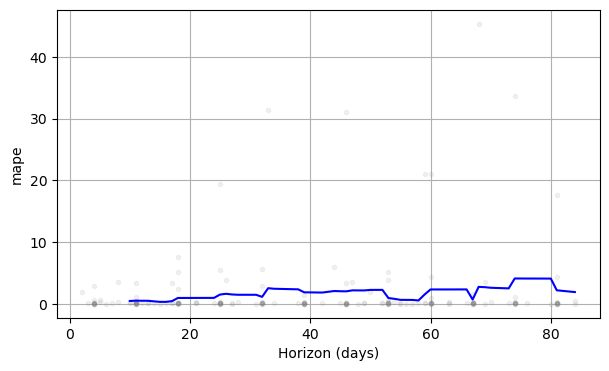

In [64]:
from prophet.plot import plot_cross_validation_metric
plt.figure(figsize=(5,5))
fig = plot_cross_validation_metric(data2, metric='mape', figsize =(7,4))

# Improvement suggetions
sales are relatively higher during holidays like Christmas and Thanksgiving than normal days so that stores can work on creating promotional offers that increase sales and generate higher revenue during festive months or on holidays.